#  PROJET PYTHON POUR LA DATA SCIENCE :
## PAR : ELARNI Maroua & SADKI Ayoub  
***
## SCRAPING DU SITE AVITO.MA : PARTIE VISUALISATION 
***
***
***


## Importation des bibliothèques necessaires 
### Seaborn matplotlib numpy et pandas

In [608]:
import pandas as pd 
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

### importation des dataframes a partir des fichiers csv 

In [609]:
df_veh = pd.read_csv('vehi.csv')
df_imm = pd.read_csv('immo.csv')
df_info = pd.read_csv('infor.csv')
df_maison = pd.read_csv('mais.csv')
df_lois = pd.read_csv('loisi.csv')
df_entr = pd.read_csv('entre.csv')
df_autr = pd.read_csv('autre.csv')
df_emp = pd.read_csv('empl.csv')
df_hab = pd.read_csv('habi.csv')
df_avito = pd.read_csv('avito.csv' , low_memory=False)
pdList = [df_veh , df_imm ,  df_info , df_maison , df_lois , df_emp , df_hab , df_entr , df_autr]  
dfList = ['vehicules' , 'immobilier' ,  'informatique' , 'maison' , 'loisir' , 'emploi' , 'habillement' , 'entreprise' , 'autres']  

FileNotFoundError: [Errno 2] File vehi.csv does not exist: 'vehi.csv'

# Quelques chiffres rapides !

##### le nombre d'annonce de chaque catégorie

In [610]:
for i in range(len(pdList)):
    print('le nombre des annonces dans ' + dfList[i] +' est : '+ str(pdList[i].shape[0]))
print("\nle nombre totale d'annoces est : " , df_avito.shape[0])

le nombre des annonces dans vehicules est : 26483
le nombre des annonces dans immobilier est : 21827
le nombre des annonces dans informatique est : 47290
le nombre des annonces dans maison est : 13036
le nombre des annonces dans loisir est : 6124
le nombre des annonces dans emploi est : 12497
le nombre des annonces dans habillement est : 6098
le nombre des annonces dans entreprise est : 14981
le nombre des annonces dans autres est : 760

le nombre totale d'annoces est :  148011


In [611]:
print("le nombre de catégories est : " , len(df_avito['catégorie'].dropna().unique()))
print("le nombre de sous-catégories est : " , len(df_avito['Type'].dropna().unique()))
print("le nombre de devises est : " , len(df_avito['devise'].dropna().unique()))
print("le nombre de types de catburants est : " , len(df_avito['Type de carburant'].dropna().unique()))
print("le nombre de modèles est : " , len(df_avito['Modèle'].dropna().unique()))
print('le nombre de villes est : ' , len(df_avito['ville'].dropna().unique()))
print('le nombre de secteurs est : ' , len(df_avito['Secteur'].dropna().unique()))
print("le nombre d'annonceurs est : " , len(df_avito['telephone'].dropna().unique()))
print("le nombre de annonceurs professionnels est : " , len(df_avito[df_avito['professionnel/particulier'] == 'professionnel']['telephone'].dropna().unique()) )
print("le nombre de annonceurs particuliers est : " , len(df_avito[df_avito['professionnel/particulier'] == 'particulier']['telephone'].dropna().unique()) )
print("le nombre de marques de véhicules est : " , len(df_avito['Marque'].dropna().unique()))

le nombre de catégories est :  9
le nombre de sous-catégories est :  57
le nombre de devises est :  1
le nombre de types de catburants est :  5
le nombre de modèles est :  607
le nombre de villes est :  425
le nombre de secteurs est :  842
le nombre d'annonceurs est :  46138
le nombre de annonceurs professionnels est :  3823
le nombre de annonceurs particuliers est :  42496
le nombre de marques de véhicules est :  59


#####  l'annonce avec le prix maximale

In [612]:
df_avito[df_avito['prix'] == df_avito['prix'].max()][['titre' , 'prix']]

,titre,prix
70604,مزرعة 225 هكتار,1.800000e+09


#####  les annonces avec le prix minimal

In [613]:
df_avito[df_avito['prix'] == df_avito['prix'].min()][['titre' , 'prix']]

,titre,prix
2166,أحفير,1.0
3590,Rétroviseurs de voiture,1.0
23085,TV GOLD VISION,1.0
25091,Porte blindée villa,1.0
26210,حمامات زجاجية حسب ذوقك,1.0
...,...,...
147759,نقل البضائع و الرحيل,1.0
147791,مواد الحلويات و التلفيف ثمن مناسب,1.0
147849,جميع انواع الحلويات بأثمنة مناسبة,1.0
147914,automatisme garage et porte,1.0


#####  l'immobilier avec la surface maximale

In [614]:
df_imm[df_imm['Surface totale'] == df_imm['Surface totale'].max()][['titre', 'Surface totale' , 'prix']]

,titre,Surface totale,prix
344,Appartement de coeur de fes,123466.0,200.0
6371,Appartement de coeur de fes,123466.0,200.0


#####  l'immobilier avec la surface minimale

In [615]:
df_imm[df_imm['Surface totale'] == df_imm['Surface totale'].min()][['titre', 'Surface totale' , 'prix' , 'devise']]

,titre,Surface totale,prix,devise
293,Terrain de 10040 m2 à 22km de Casablanca,1.0,NaN,NaN
786,vente d'un terrain agricole,1.0,4024000.0,DH
1404,Terrain 1 hectare villa,1.0,8000000.0,DH
1514,Terrain,1.0,NaN,NaN
1517,Terrain,1.0,200000.0,DH
...,...,...,...,...
21432,ارض فلاحية على الطريق بين اسفي و ثلاتاء بوكدرة,1.0,620000.0,DH
21461,Les Café Morlice,1.0,60.0,DH
21465,ارض فلاحية,1.0,620000.0,DH
21546,Terrain et ferme en Vente à Belfaa,1.0,700000.0,DH


#####  Que les voitures

In [616]:
df_v = df_veh[df_veh['Type'] == 'Voitures, Offre']
df_v.head()

,titre,description,catégorie,prix,devise,ville,professionnel/particulier,vues,nom,telephone,...,Heure,lien,Année-Modèle,Kilométrage,Type de carburant,Marque,Modèle,Puissance fiscale,Secteur,Type
0,Kia pikanto -2007,Kia pikanto modil 2007 boita otomatic clima ma...,Vehicules,59000.0,DH,Tétouan,professionnel,3496,Auto Paloma,MA: +212-671370881,...,15:18,https://www.avito.ma/fr/centre_ville/voitures/...,2007.0,79999.0,Essence,Kia,Picanto,5 CV,Centre ville,"Voitures, Offre"
1,Dacia Sandero Diesel -2014,Dacia sandero Diesl n9iya 3amra libraha marhba,Vehicules,80000.0,DH,Tétouan,professionnel,7491,Auto Paloma,MA: +212-671370881,...,15:17,https://www.avito.ma/fr/centre_ville/voitures/...,2014.0,189999.0,Diesel,Dacia,Sandero,6 CV,Centre ville,"Voitures, Offre"
2,BMW Serie 6 Diesel -2016,Auto hicham met en vente une BMW Serie 6 Diese...,Vehicules,NaN,NaN,Casablanca,professionnel,9608,Auto Hicham,MA: +212-661075418,...,15:17,https://www.avito.ma/fr/belvedere/voitures/BMW...,2016.0,84999.0,Diesel,BMW,Serie 6,12 CV,Belvédère,"Voitures, Offre"
4,golf 4 diesel -1999,je mets en vente une très belle golf 4 match2 ...,Vehicules,87000.0,DH,Oujda,professionnel,673,Al Watani Immo,MA: +212-661360143,...,15:15,https://www.avito.ma/fr/oujda/voitures/golf_4_...,1999.0,299999.0,Diesel,Volkswagen,COCCINELLE,8 CV,Autre secteur,"Voitures, Offre"
5,Mercedes pack Amg -2008,c220 pack AMG diwana 2015 . tous options . dou...,Vehicules,NaN,NaN,Kénitra,particulier,18,mohammed lyazghi,MA: +212-629194085,...,15:15,https://www.avito.ma/fr/kénitra/voitures/Merce...,2008.0,14999.0,Diesel,Mercedes-Benz,220,9 CV,NaN,"Voitures, Offre"


#####  la voiture la plus chère

In [617]:
df_v[df_v['prix'] == df_v['prix'].max()][['titre', 'prix', 'devise','professionnel/particulier', 'Année-Modèle', 'Kilométrage', 'Type de carburant', 'Marque', 'Modèle', 'Puissance fiscale',]]

,titre,prix,devise,professionnel/particulier,Année-Modèle,Kilométrage,Type de carburant,Marque,Modèle,Puissance fiscale
23616,golf 4 -2002,8500000.0,DH,particulier,2002.0,109999.0,Diesel,Volkswagen,GOLF 4,8 CV


#####  la voiture  la moins chère

In [618]:
df_v[df_v['prix'] == df_v['prix'].min()][['titre', 'prix', 'devise','professionnel/particulier', 'Année-Modèle', 'Kilométrage', 'Type de carburant', 'Marque', 'Modèle', 'Puissance fiscale',]]

,titre,prix,devise,professionnel/particulier,Année-Modèle,Kilométrage,Type de carburant,Marque,Modèle,Puissance fiscale
7112,Fiat 127 -1983,4000.0,DH,particulier,1983.0,19999.0,Essence,Fiat,127,5 CV


#####  les voitures les plus neuves

In [619]:
df_vn = df_v[df_v['Année-Modèle'] == df_v['Année-Modèle'].max()][['titre', 'prix', 'devise','professionnel/particulier', 'Année-Modèle', 'Kilométrage', 'Type de carburant', 'Marque', 'Modèle', 'Puissance fiscale',]]
df_vn.head()

,titre,prix,devise,professionnel/particulier,Année-Modèle,Kilométrage,Type de carburant,Marque,Modèle,Puissance fiscale
85,Seat Leon -2020,280000.0,DH,particulier,2020.0,4999.0,Diesel,Seat,Leon,NaN
328,Audi SQ8 tdi Quattro S-line diesel -2020,NaN,NaN,professionnel,2020.0,4999.0,Diesel,Audi,Q8,NaN
348,Audi SQ7 Diesel -2020,NaN,NaN,professionnel,2020.0,4999.0,Diesel,Audi,Q7,12 CV
359,Audi SQ2 essence -2020,NaN,NaN,professionnel,2020.0,4999.0,Essence,Audi,Allroad,11 CV
424,Maserati levante diesel -2020,NaN,NaN,professionnel,2020.0,4999.0,Diesel,Maserati,other,12 CV


#####  les voitures les plus anciennes

In [620]:
df_va = df_v[df_v['Année-Modèle'] == df_v['Année-Modèle'].min()][['titre', 'prix', 'devise','professionnel/particulier', 'Année-Modèle', 'Kilométrage', 'Type de carburant', 'Marque', 'Modèle', 'Puissance fiscale',]]
print('leurs nombre est de : ' , df_va.shape[0])
df_va.head()

leurs nombre est de :  43


,titre,prix,devise,professionnel/particulier,Année-Modèle,Kilométrage,Type de carburant,Marque,Modèle,Puissance fiscale
681,renault 12,NaN,NaN,professionnel,1980.0,169999.0,Essence,Autres,Autres,NaN
1298,Jaguar de Collection modèle 1970,NaN,NaN,particulier,1980.0,4999.0,Essence,Jaguar,XJ6,NaN
1305,Mercedes de Collection modèle 1969,NaN,NaN,particulier,1980.0,4999.0,Essence,Mercedes-Benz,280,NaN
2205,Mercedes collection 280s,NaN,NaN,particulier,1980.0,4999.0,Diesel,Mercedes-Benz,Classe S,10 CV
2298,reneaut 12 model 77 diwana91,20000.0,DH,particulier,1980.0,4999.0,Essence,Renault,12,7 CV


#####  Que les motos

In [621]:
df_m = df_veh[df_veh['Type'] == 'Motos, Offre']
df_m.head()

,titre,description,catégorie,prix,devise,ville,professionnel/particulier,vues,nom,telephone,...,Heure,lien,Année-Modèle,Kilométrage,Type de carburant,Marque,Modèle,Puissance fiscale,Secteur,Type
8,DIRECT SCOOTER -2010,DIRECT SCOOTER,Vehicules,4000.0,DH,Casablanca,particulier,11,salah,MA: +212-663269477,...,15:12,https://www.avito.ma/fr/casablanca/motos/DIREC...,2010.0,4999.0,NaN,NaN,NaN,NaN,NaN,"Motos, Offre"
24,Moto docker sanya becane -2020,بمناسبة إفتتاح اكبر مركز لدراجات النارية في ال...,Vehicules,7490.0,DH,Casablanca,professionnel,2818,دراجات الأخوين,MA: +212-696039431,...,15:07,https://www.avito.ma/fr/anfa/motos/Moto_docker...,2020.0,4999.0,NaN,NaN,NaN,NaN,Anfa,"Motos, Offre"
40,sh robo -2015,sh robo 2015,Vehicules,24500.0,DH,Tanger,particulier,28,aymane,MA: +212-611720386,...,15:03,https://www.avito.ma/fr/marjane/motos/sh_robo_...,2015.0,9999.0,NaN,NaN,NaN,NaN,Marjane,"Motos, Offre"
42,Spirit presque neuf -2003,Spirit 2003 presque neuf diwana 2018,Vehicules,10000.0,DH,Fès,professionnel,16,Achraf-top,MA: +212-661879523,...,15:03,https://www.avito.ma/fr/hay_saada/motos/Spirit...,2003.0,14999.0,NaN,NaN,NaN,NaN,Hay Saada,"Motos, Offre"
50,sh robo -2015,sh robo 2015,Vehicules,24500.0,DH,Tanger,particulier,30,aymane,MA: +212-611720386,...,15:03,https://www.avito.ma/fr/marjane/motos/sh_robo_...,2015.0,9999.0,NaN,NaN,NaN,NaN,Marjane,"Motos, Offre"


#####  la moto  la plus chère

In [622]:
df_m[df_m['prix'] == df_m['prix'].max()][['titre', 'prix', 'devise','professionnel/particulier', 'Année-Modèle', 'Kilométrage', 'Type de carburant', 'Marque', 'Modèle', 'Puissance fiscale',]]

,titre,prix,devise,professionnel/particulier,Année-Modèle,Kilométrage,Type de carburant,Marque,Modèle,Puissance fiscale
25611,sh smart key -2019,400000.0,DH,particulier,2019.0,19999.0,NaN,NaN,NaN,NaN


#####  la moto la moins chère

In [623]:
df_m[df_m['prix'] == df_m['prix'].min()][['titre', 'prix', 'devise','professionnel/particulier', 'Année-Modèle', 'Kilométrage', 'Type de carburant', 'Marque', 'Modèle', 'Puissance fiscale',]]

,titre,prix,devise,professionnel/particulier,Année-Modèle,Kilométrage,Type de carburant,Marque,Modèle,Puissance fiscale
311,motor 103 -2020,20.0,DH,particulier,2020.0,9999.0,NaN,NaN,NaN,NaN


#####  les motos les pus neuves

In [624]:
df_mn = df_m[df_m['Année-Modèle'] == df_m['Année-Modèle'].max()][['titre', 'prix', 'devise','professionnel/particulier', 'Année-Modèle', 'Kilométrage', 'Type de carburant', 'Marque', 'Modèle', 'Puissance fiscale',]]
print('leurs nombre est de : ' , df_mn.shape[0])
df_mn.head()

leurs nombre est de :  187


,titre,prix,devise,professionnel/particulier,Année-Modèle,Kilométrage,Type de carburant,Marque,Modèle,Puissance fiscale
24,Moto docker sanya becane -2020,7490.0,DH,professionnel,2020.0,4999.0,NaN,NaN,NaN,NaN
60,Becane sh -2020,NaN,NaN,professionnel,2020.0,4999.0,NaN,NaN,NaN,NaN
66,Gabelli grido -2020,10500.0,DH,professionnel,2020.0,4999.0,NaN,NaN,NaN,NaN
94,moto -2020,11400.0,DH,particulier,2020.0,499999.0,NaN,NaN,NaN,NaN
283,sanya fice 110cc -2020,10200.0,DH,particulier,2020.0,4999.0,NaN,NaN,NaN,NaN


#####  les motos les pus anciennes

In [625]:
df_ma = df_m[df_m['Année-Modèle'] == df_m['Année-Modèle'].min()][['titre', 'prix', 'devise','professionnel/particulier', 'Année-Modèle', 'Kilométrage', 'Type de carburant', 'Marque', 'Modèle', 'Puissance fiscale',]]
print('leurs nombre est de : ' , df_ma.shape[0])
df_ma.head()

leurs nombre est de :  13


,titre,prix,devise,professionnel/particulier,Année-Modèle,Kilométrage,Type de carburant,Marque,Modèle,Puissance fiscale
1213,103 Peugeot,3000.0,DH,particulier,1980.0,24999.0,NaN,NaN,NaN,NaN
1852,bmw R60/6,NaN,NaN,particulier,1980.0,4999.0,NaN,NaN,NaN,NaN
6784,solex 1968,8000.0,DH,particulier,1980.0,4999.0,NaN,NaN,NaN,NaN
7618,ديربي,3800.0,DH,particulier,1980.0,54999.0,NaN,NaN,NaN,NaN
8517,Sh sakata,26000.0,DH,particulier,1980.0,24999.0,NaN,NaN,NaN,NaN


#####  Que les vélos

In [626]:
df_vl = df_veh[df_veh['Type'] == 'Vélos, Offre']
print("leurs nombre est de : " , df_vl.shape[0])
df_vl.head()

leurs nombre est de :  1555


,titre,description,catégorie,prix,devise,ville,professionnel/particulier,vues,nom,telephone,...,Heure,lien,Année-Modèle,Kilométrage,Type de carburant,Marque,Modèle,Puissance fiscale,Secteur,Type
9,Bitwin 560,VTT professionnel tout peis oréjinal ét bon ét...,Vehicules,3300.0,DH,Casablanca,particulier,9,yassin tanjaoui,MA: +212-675798724,...,15:12,https://www.avito.ma/fr/casablanca/vélos/Bitwi...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Vélos, Offre"
25,VTT Conway MS Noir taille M 27.5 pouces 2019,"VTT Conway MS 527 aluminium 2019 neuf, importé...",Vehicules,NaN,NaN,Rabat,professionnel,19,Super Vélo,MA: +212-666661750,...,15:06,https://www.avito.ma/fr/taqaddoum/vélos/VTT_Co...,NaN,NaN,NaN,NaN,NaN,NaN,Taqaddoum,"Vélos, Offre"
27,VTC Serious Cedar taille M aluminium V-Brake 2019,"VTC Serious Cedar aluminium 2019 neuf, importé...",Vehicules,NaN,NaN,Rabat,professionnel,10,Super Vélo,MA: +212-666661750,...,15:06,https://www.avito.ma/fr/taqaddoum/vélos/VTC_Se...,NaN,NaN,NaN,NaN,NaN,NaN,Taqaddoum,"Vélos, Offre"
28,VTC Btwin Original taille L aluminium V-Brake,"VTC Btwin Original 5 gris comme neuf, importé ...",Vehicules,NaN,NaN,Rabat,professionnel,10,Super Vélo,MA: +212-666661750,...,15:06,https://www.avito.ma/fr/taqaddoum/vélos/VTC_Bt...,NaN,NaN,NaN,NaN,NaN,NaN,Taqaddoum,"Vélos, Offre"
33,VTC City 45 taille M 26 pouces modele 2019 neuf,"VTC City 45 modele 2019 comme neuf, importé d'...",Vehicules,NaN,NaN,Rabat,professionnel,5,Super Vélo,MA: +212-666661750,...,15:04,https://www.avito.ma/fr/taqaddoum/vélos/VTC_Ci...,NaN,NaN,NaN,NaN,NaN,NaN,Taqaddoum,"Vélos, Offre"


#####  le vélo  le plus chèr

In [627]:
df_vl[df_vl['prix'] == df_vl['prix'].max()][['titre', 'prix', 'devise','professionnel/particulier', 'Année-Modèle', 'Kilométrage', 'Type de carburant', 'Marque', 'Modèle', 'Puissance fiscale',]]

,titre,prix,devise,professionnel/particulier,Année-Modèle,Kilométrage,Type de carburant,Marque,Modèle,Puissance fiscale
2859,Jamla vente vélos los neuf en gros 100 minimum,62000.0,DH,particulier,NaN,NaN,NaN,NaN,NaN,NaN


#####  le vélo le moins chèr

In [628]:
df_vl[df_vl['prix'] == df_vl['prix'].min()][['titre', 'prix', 'devise','professionnel/particulier', 'Année-Modèle', 'Kilométrage', 'Type de carburant', 'Marque', 'Modèle', 'Puissance fiscale',]]

,titre,prix,devise,professionnel/particulier,Année-Modèle,Kilométrage,Type de carburant,Marque,Modèle,Puissance fiscale
12508,Vélo,50.0,DH,particulier,NaN,NaN,NaN,NaN,NaN,NaN


<font color=red>
on remarque que quelques chiffres sont clairement faux (surtout les prix) cela est du au la non transparence de quelques annonceurs qui postent soit de fausse informations soit des arnaques
</font>

# PLOTS
***

# I / Quelques statistiques en fonction de chaque catégorie
### ---------------1) figure représentative des nombres d'annonces par catégorie 

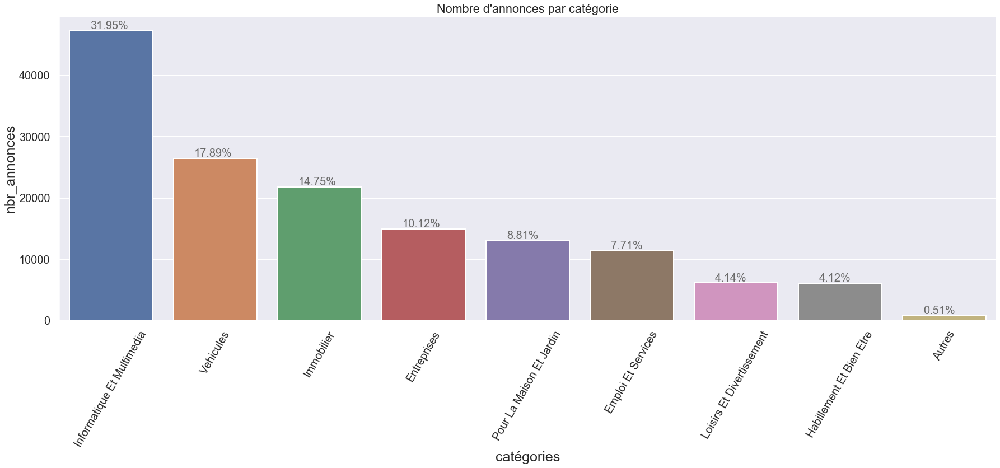

In [629]:
f = df_avito.groupby("catégorie").count().sort_values(by=['titre'],ascending=False)[['titre']]
sns.set(style="darkgrid")
sns.set_context('poster' , font_scale=0.9 , rc = {'font_size' : 60 , 'axes.labelsize' : 25})
plt.figure(figsize=(30, 10))
ax = sns.barplot(x = f.iloc[:,0].index , y = f['titre'] , data = f)
ax.set(xlabel="catégories", ylabel = "nbr_annonces")
plt.title("Nombre d'annonces par catégorie")
for item in ax.get_xticklabels():
    item.set_rotation(60)
totals = []
for i in ax.patches:
    totals.append(i.get_height())
total = sum(totals)
for i in ax.patches:
    ax.text(i.get_x()+.2, i.get_height()+300, str(round((i.get_height()/total)*100, 2))+'%' , fontsize=20,color='dimgrey')

### ---------------2) figure représentative des nombres de vues par catégorie 

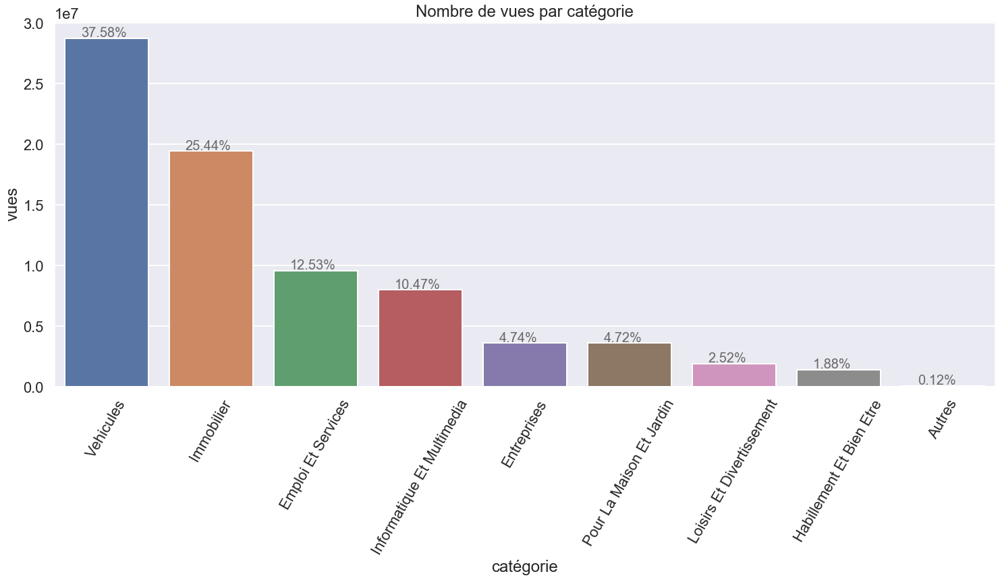

In [630]:
df_vues = df_avito.groupby('catégorie').sum().sort_values('vues',ascending=False)

sns.set(style="darkgrid")
sns.set_context( 'poster')
plt.figure(figsize=(25, 10))
plt.title("Nombre de vues par catégorie")

ax = sns.barplot(x = df_vues.index , y='vues' , data = df_vues  , estimator = np.sum ,ci=.1  )
for item in ax.get_xticklabels():
    item.set_rotation(60)
    
totals = []
for i in ax.patches:
    totals.append(i.get_height())
total = sum(totals)
for i in ax.patches:
    ax.text(i.get_x()+0.155, i.get_height()+100000, str(round((i.get_height()/total)*100, 2))+'%' , fontsize=20,color='dimgrey')

### ---------------3) figure représentative de la moyenne des prix par catégorie 

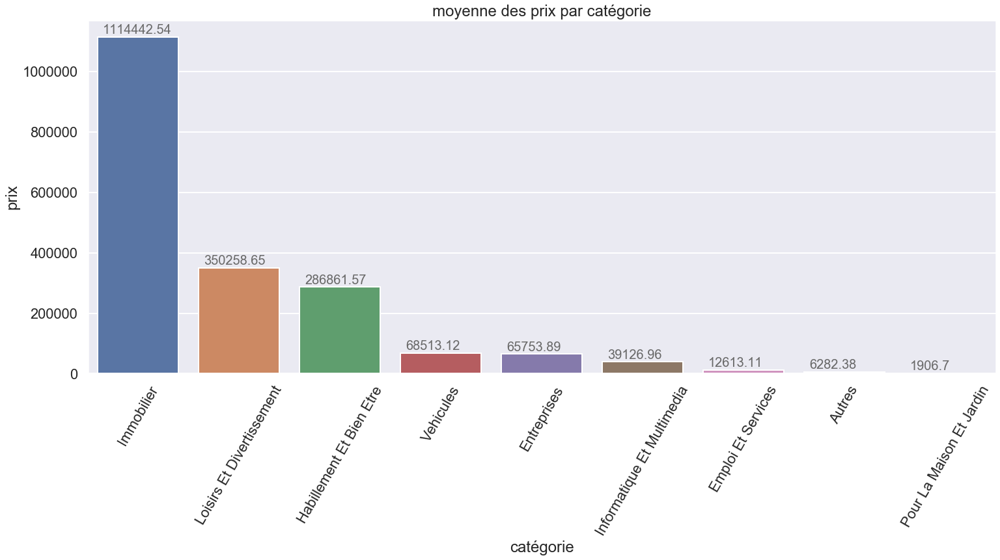

In [631]:
s = df_avito.groupby('catégorie').mean()[['prix']].sort_values('prix' , ascending = False)
sns.set(style="darkgrid")
sns.set_context( 'poster')

plt.figure(figsize=(25, 10))
plt.title("moyenne des prix par catégorie")
ax = sns.barplot(x='catégorie' , y='prix' , data = df_avito , ci = .001 , order = s.index)
for item in ax.get_xticklabels():
    item.set_rotation(60)
    
totals = []
for i in ax.patches:
    totals.append(i.get_height())
total = sum(totals)
for i in ax.patches:
    ax.text(i.get_x()+0.05, i.get_height()+10000, str((round(i.get_height() , 2))) , fontsize=20,color='dimgrey')

<font color = red>
On remarque que les moyennes des prix sont trop élevées chose due a des donnés éronées entrées par quelques annonceurs
</font>

# II / Quelques statistiques en fonction de chaque ville
### ---------------1)figure représentative des nombres d'annonces par ville qui dépassent la barre des 200

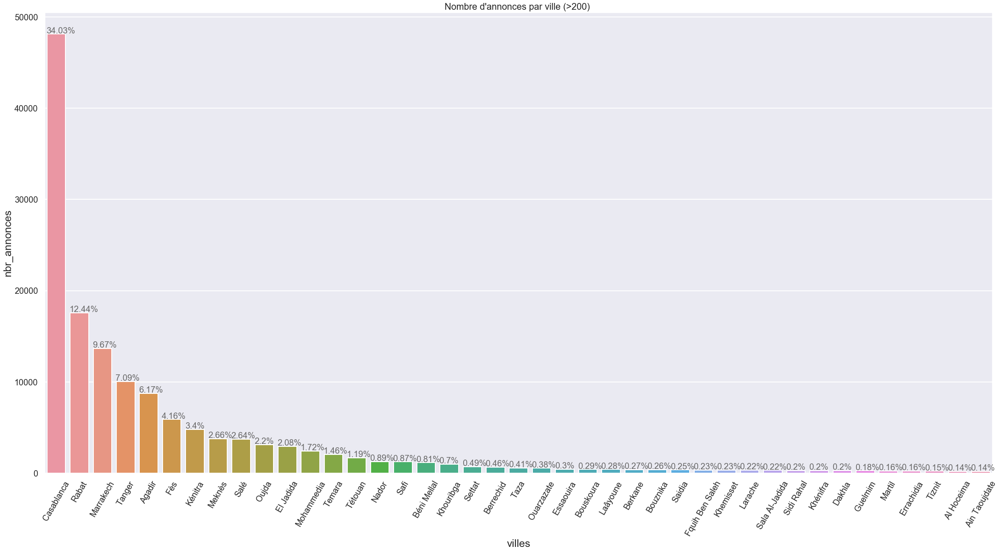

In [632]:
d = df_avito.groupby("ville").count().sort_values(by=['titre'],ascending=False)[['titre']]
dd = d[d['titre'] > 200]
plt.figure(figsize=(40, 20))
sns.set(style="darkgrid")
sns.set_context('poster' , font_scale=0.9 , rc = {'font_size' : 60 , 'axes.labelsize' : 25})
ax = sns.barplot(x = dd.iloc[:,0].index , y='titre' , data = dd)
plt.title("Nombre d'annonces par ville (>200) ")
ax.set(xlabel="villes", ylabel = "nbr_annonces")

for item in ax.get_xticklabels():
    item.set_rotation(60)
    
totals = []
for i in ax.patches:
    totals.append(i.get_height())
total = sum(totals)
for i in ax.patches:
    ax.text(i.get_x()-.03, i.get_height()+100, str(round((i.get_height()/total)*100, 2))+'%' , fontsize=20,color='dimgrey')

### ---------------2)figure représentative des nombres de vues par ville qui dépassent la barre des 50000

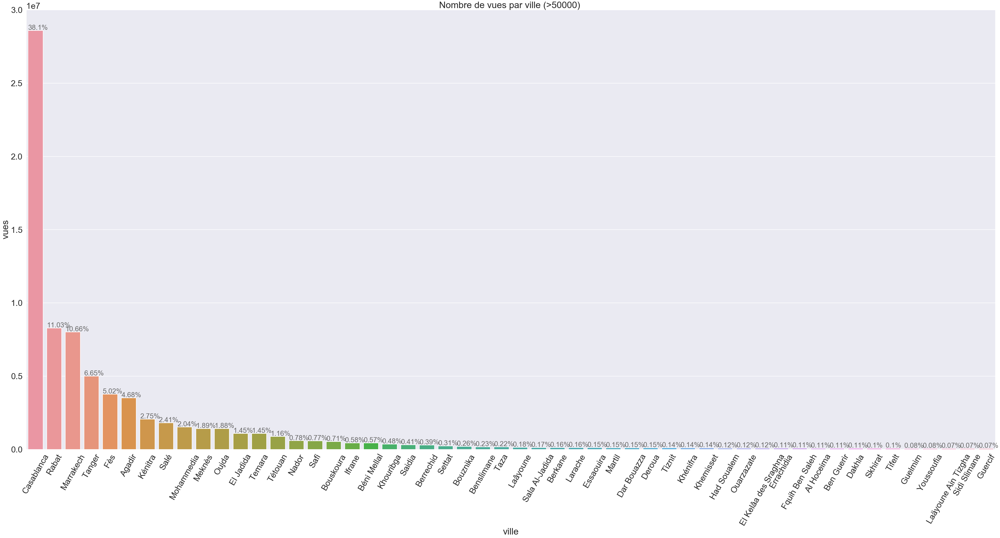

In [633]:
d = df_avito.groupby("ville")[['vues']].sum().sort_values(by = 'vues' , ascending=False)
dd = d[d['vues'] > 50000]

sns.set(style="darkgrid")
plt.figure(figsize=(75, 35))
sns.set_context ( 'poster' , font_scale = 1.65)

ax = sns.barplot(x = dd.iloc[:,0].index , y='vues' , data = dd)

plt.title("Nombre de vues par ville (>50000) ")
for item in ax.get_xticklabels():
    item.set_rotation(60)
totals = []
for i in ax.patches:
    totals.append(i.get_height())
total = sum(totals)
for i in ax.patches:
    ax.text(i.get_x()+.01, i.get_height()+50000, str(round((i.get_height()/total)*100, 2))+'%', fontsize=30,color='dimgrey')

### ---------------3)figure représentative des moyennes des prix par ville qui dépassent la barre des 500 000

In [634]:
d = df_avito.groupby("ville")[['prix']].mean().sort_values(by = 'prix' , ascending=False)
dd = d[d['prix'] > 500000]

sns.set(style="darkgrid")
plt.figure(figsize=(200, 100))
sns.set_context ( 'poster' , font_scale = 4.5)
plt.title("Moyenne des prix par ville ")

ax = sns.barplot(x = dd.index , y='prix' , data = dd ,  ci = .01  )

for item in ax.get_xticklabels():
    item.set_rotation(70)
totals = []
for i in ax.patches:
    totals.append(i.get_height())
total = sum(totals)
for i in ax.patches:
    ax.text(i.get_x(), i.get_height()+300000, str(round(i.get_height()/1, 2)), fontsize=50,color='dimgrey')

### ---------------4)figure représentative du nombre d'annoceurs professionnels par ville (50 premieres villes)

In [635]:
df_pro = df_avito[df_avito['professionnel/particulier'] == 'professionnel']
df_pro_unique = df_pro.drop_duplicates(subset=['telephone'])
df_pro_unique_sorted = df_pro_unique.groupby('ville').count().sort_values('titre', ascending = False)
dpro = df_pro_unique_sorted[0:50]
nbr_pro = df_pro['telephone'].unique().shape[0]

df_par = df_avito[df_avito['professionnel/particulier'] == 'particulier']
df_par_unique = df_par.drop_duplicates(subset=['telephone'])
df_par_unique_sorted = df_par_unique.groupby('ville').count().sort_values('titre', ascending = False)
dpar = df_par_unique_sorted[0:50]
nbr_par = df_par['telephone'].unique().shape[0]

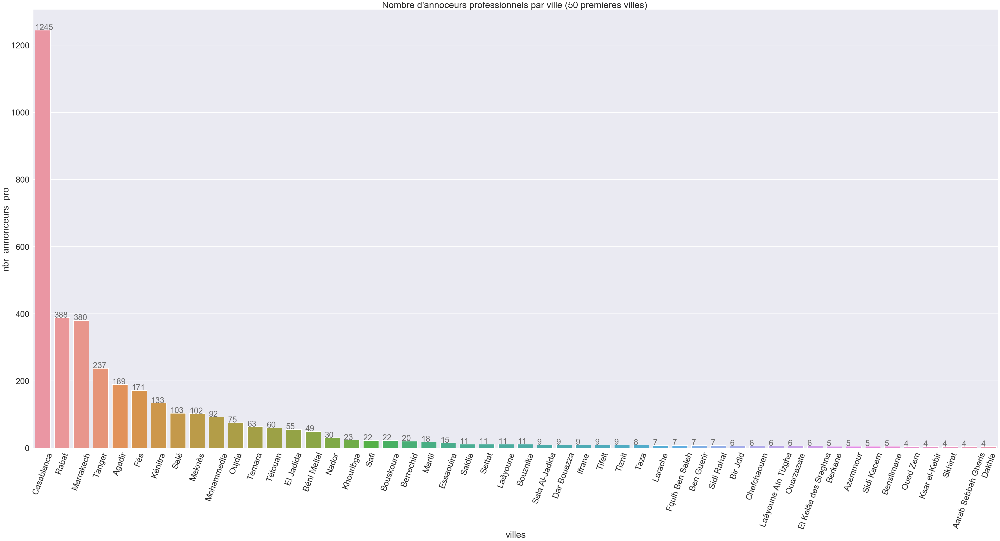

In [636]:
sns.set(style="darkgrid")
plt.figure(figsize=(75, 35))
sns.set_context ( 'poster' , font_scale = 1.65)
plt.title("Nombre d'annoceurs professionnels par ville (50 premieres villes) ")

ax = sns.barplot(x = dpro.index , y ='titre' ,  data = dpro  )
ax.set(xlabel="villes", ylabel = "nbr_annonceurs_pro")

for item in ax.get_xticklabels():
    item.set_rotation(70)
totals = []
for i in ax.patches:
    totals.append(i.get_height())
total = sum(totals)
for i in ax.patches:
    ax.text(i.get_x(), i.get_height()+1, str(int(i.get_height())), fontsize=35,color='dimgrey')

### ---------------5)figure représentative du nombre d'annoceurs particuliers par ville (50 premieres villes)

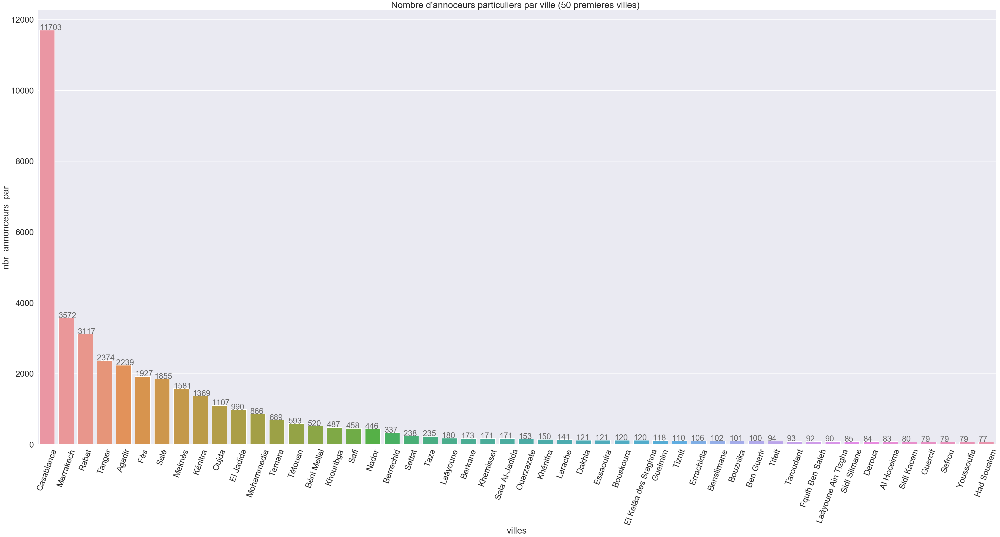

In [637]:
sns.set(style="darkgrid")
plt.figure(figsize=(75, 35))
sns.set_context ( 'poster' , font_scale = 1.65)
plt.title("Nombre d'annoceurs particuliers par ville (50 premieres villes) ")

ax = sns.barplot(x = dpar.index , y ='titre' ,  data = dpar  )
ax.set(xlabel="villes", ylabel = "nbr_annonceurs_par")

for item in ax.get_xticklabels():
    item.set_rotation(70)
totals = []
for i in ax.patches:
    totals.append(i.get_height())
total = sum(totals)
for i in ax.patches:
    ax.text(i.get_x(), i.get_height()+1, str(int(i.get_height())), fontsize=35,color='dimgrey')

# III / Quelques statistiques pour la catégorie véhicules
### ---------------1)figure représentative des nombres d'annonces par marque de véhicules

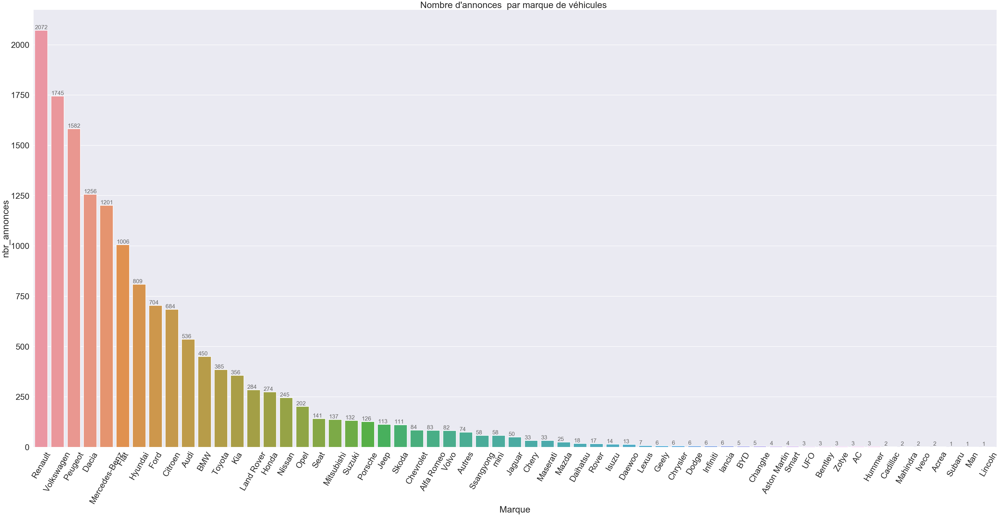

In [638]:
df_veh_count = df_veh.groupby('Marque').count().sort_values('titre' , ascending = False)

sns.set(style="darkgrid")
plt.figure(figsize=(75, 35))
sns.set_context ( 'poster' , font_scale = 1.65)

ax = sns.barplot(x =  df_veh_count.index ,y = 'titre', data = df_veh_count )
ax.set(xlabel="Marque", ylabel = "nbr_annonces")

plt.title("Nombre d'annonces  par marque de véhicules ")

for item in ax.get_xticklabels():
    item.set_rotation(60)
    
totals = []

for i in ax.patches:
    totals.append(i.get_height())
    
total = sum(totals)

for i in ax.patches:
    ax.text(i.get_x()+.01, i.get_height()+6, str(int(i.get_height())), fontsize=25,color='dimgrey')

### ---------------2)figure représentative des nombres de vues par marque de véhicules

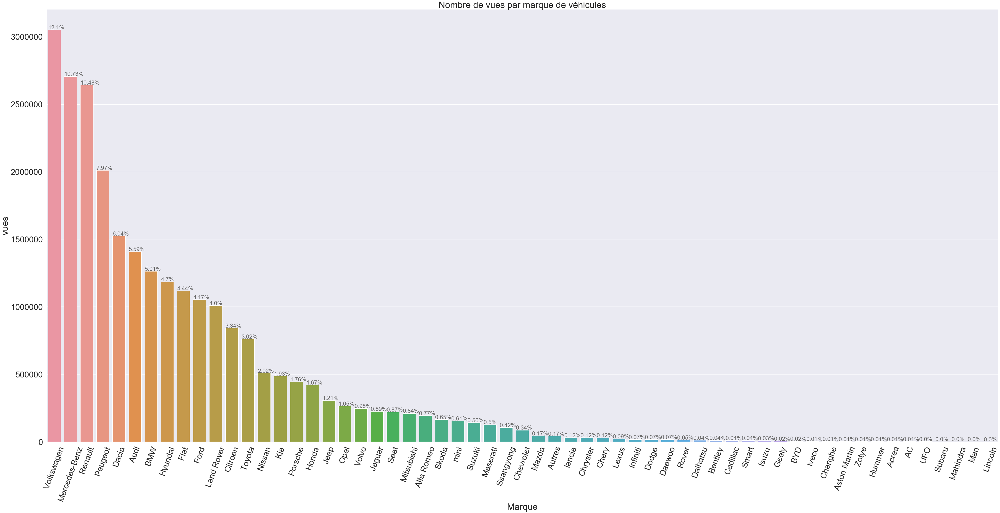

In [639]:
df_veh_count= df_veh.groupby('Marque').sum().sort_values('vues' , ascending = False)

sns.set(style="darkgrid")
plt.figure(figsize=(75, 35))
sns.set_context ( 'poster' , font_scale = 1.65)

plt.title("Nombre de vues par marque de véhicules")

ax = sns.barplot(x = df_veh_count.index , y='vues' , data = df_veh_count ,  ci = .01  )

for item in ax.get_xticklabels():
    item.set_rotation(70)
sns.set_context ( 'poster' , font_scale=1.5)    
totals = []
for i in ax.patches:
    totals.append(i.get_height())
total = sum(totals)
for i in ax.patches:
    ax.text(i.get_x(), i.get_height()+5000, str(round((i.get_height()/total)*100, 2))+'%', fontsize=25,color='dimgrey')

### ---------------3)figure représentative des nombres de vues par marque de véhicules pro/par

In [640]:
dd = df_veh.groupby('Marque').sum().sort_values('vues' , ascending = False )
sns.set(style="darkgrid")
plt.figure(figsize=(400, 200))
sns.set_context ( 'poster' , font_scale = 15.5)
ax = sns.barplot(x='Marque' , y='vues' , hue='professionnel/particulier' , data = df_veh , estimator = sum , ci =.001 , order =dd.index[:35] )
plt.title("Nombre de vues  par marque (35 premières marques)")
plt.legend(title='professionnel/particulier', loc='upper right')
for item in ax.get_xticklabels():
    item.set_rotation(70)

### ---------------4)figure représentative des nombres d'annonces par type d'annonces de la catégorie véhicules

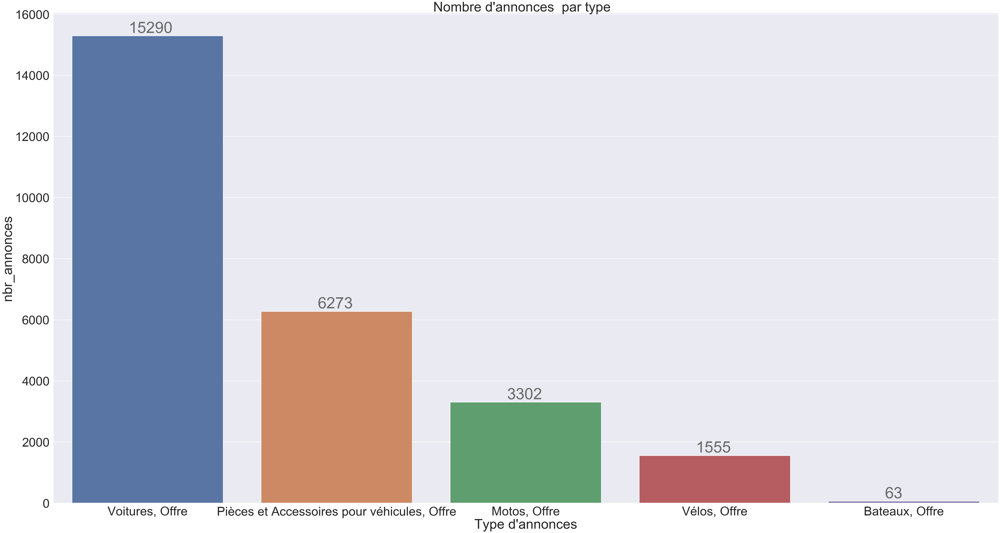

In [641]:
df_tv = df_veh.groupby('Type').count().sort_values('titre' , ascending = False)
sns.set(style="darkgrid")
plt.figure(figsize=(75, 40))
sns.set_context ( 'poster' , font_scale = 2.5)
ax = sns.barplot(x=df_tv.index ,y='titre', data=df_tv)
plt.title("Nombre d'annonces  par type  ")
ax.set(xlabel="Type d'annonces", ylabel = "nbr_annonces")

totals = []

for i in ax.patches:
    totals.append(i.get_height())
    
total = sum(totals)

for i in ax.patches:
    ax.text(i.get_x()+.3, i.get_height()+100, str(int(i.get_height())), fontsize=70,color='dimgrey')

### ---------------5)figure représentative du nombre de vues par année modèle du véhicules

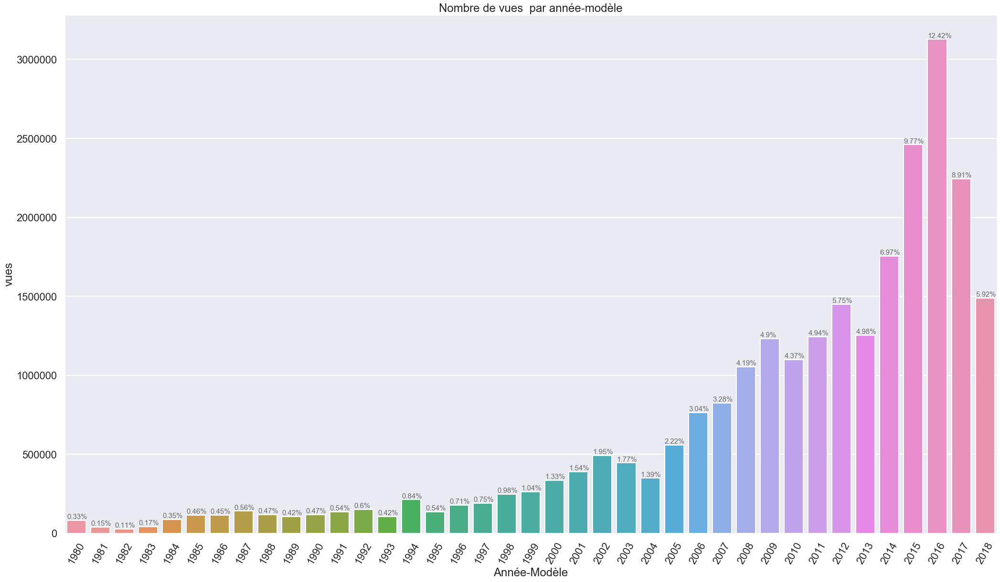

In [642]:
sns.set(style="darkgrid")
plt.figure(figsize=(35, 20))
sns.set_context ( 'poster')
ax = sns.barplot(x = 'Année-Modèle' , y='vues' , data = df_veh  , estimator = np.sum , order = list(range(1980, 2018+1)) , ci=.01)
plt.title("Nombre de vues  par année-modèle")

for item in ax.get_xticklabels():
    item.set_rotation(60)
totals = []

for i in ax.patches:
    totals.append(i.get_height())
    
total = sum(totals)

for i in ax.patches:
    ax.text(i.get_x()+.005, i.get_height()+10000, str(round((i.get_height()/total)*100, 2))+'%', fontsize=15,color='dimgrey')

### ---------------6)Figure représentative de la moyenne des prix par marque pour chaque type de carburant

<font color = red >le programme marche comme souhaité mais on pense qu'un beug se produit  lors de l'execution ce qui fait que un message d'erreur s'affiche plusieurs fois avant le résultat souhaité
</font>

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

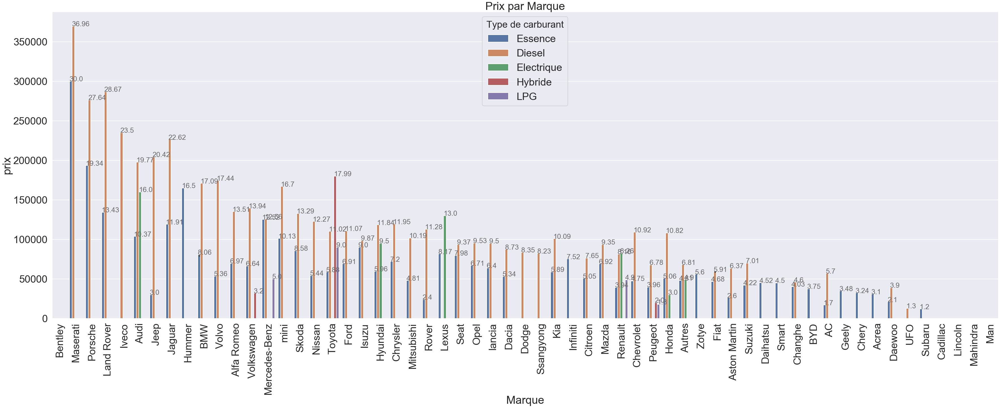

In [643]:
a = df_veh.groupby('Marque').mean()[['prix']].sort_values('prix' , ascending = False)

plt.figure(figsize=(60, 40))

sns.set(style="darkgrid")
sns.set_context ( 'poster' , font_scale = 1.65)
plt.title("Prix par Marque")

ax = sns.barplot(x="Marque", y="prix",hue="Type de carburant", data=df_veh[df_veh['prix']<600000] , ci = .01 , order = a.index)
for item in ax.get_xticklabels():
    item.set_rotation(90)
    
totals = []
for i in ax.patches:
    totals.append(i.get_height())
total = sum(totals)
for i in ax.patches:
    ax.text(i.get_x(), i.get_height(), str(round(i.get_height()/10000, 2)), fontsize=25,color='dimgrey')

### ---------------7)Figure représentative de l'abondance des annonces pro de véhicules en fonction de l'année-modèle et du prix 

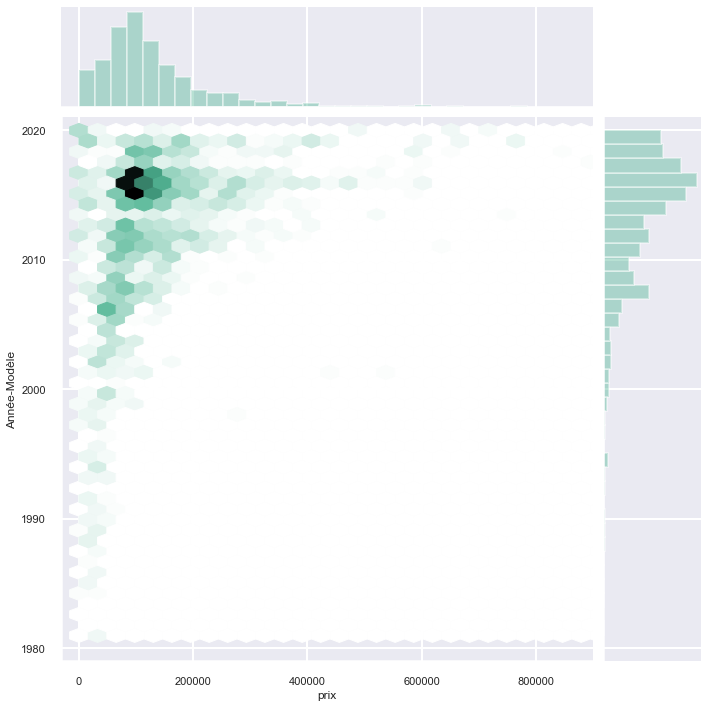

In [646]:
veh_pro = df_veh[df_veh['professionnel/particulier'] =='professionnel' ]
veh_pro_nn = veh_pro[veh_pro['prix'].notnull()]
sns.jointplot('prix' , 'Année-Modèle' , data = veh_pro_nn  ,dropna = True ,height=10, ratio=5, space=.1, color="#4CB391" ,kind = 'hex ', xlim=(-30000,900000), ylim=(1979,2021))
sns.set_context ( 'poster' , font_scale = 1.5)


### ---------------8)Figure représentative de l'abondance des annonces de particuliers de véhicules en fonction de l'année-modèle et du prix 

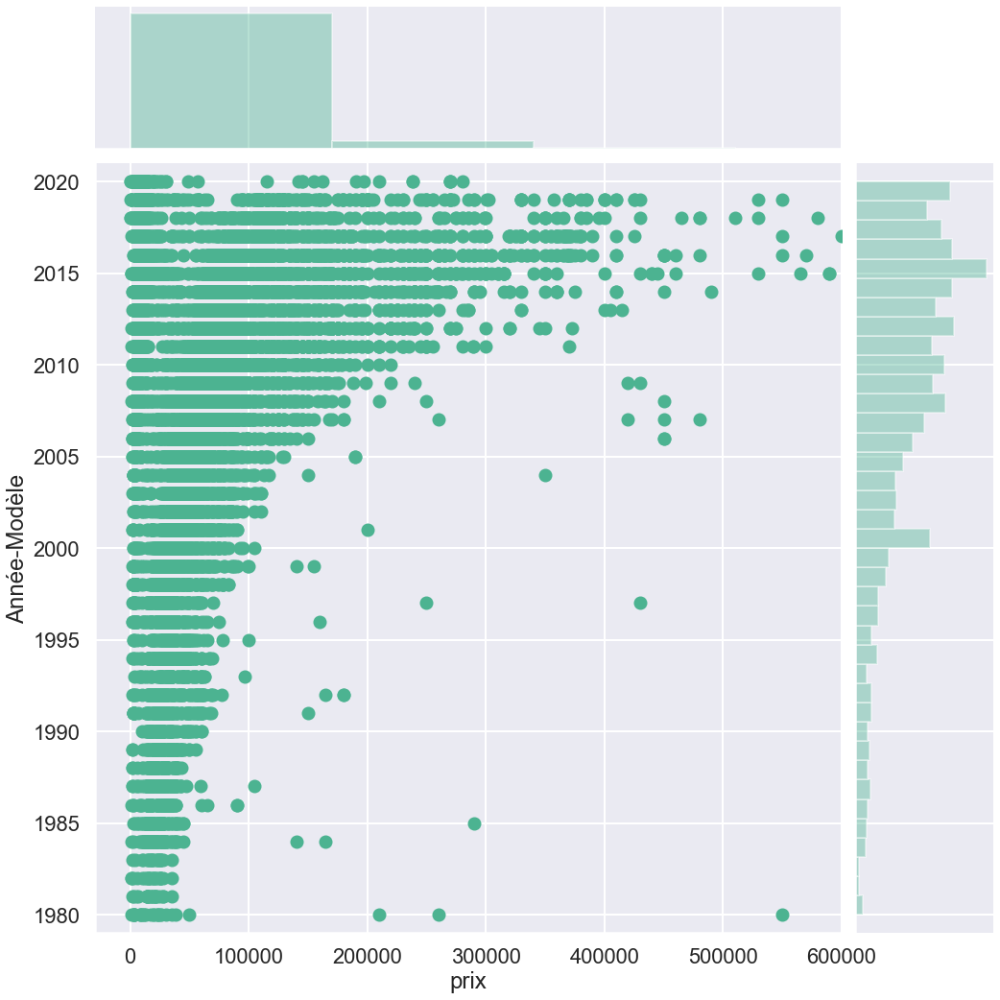

In [647]:
veh_par = df_veh[df_veh['professionnel/particulier'] =='particulier' ]
sns.set_context ( 'poster' , font_scale = 1)
sns.jointplot('prix' , 'Année-Modèle' , data = veh_par  ,dropna = True ,height=15, ratio=5, space=.1, color="#4CB391" , xlim=(-30000,600000), ylim=(1979,2021))

### ---------------9)Figure représentative du prix moyen par année modele de chaque marque

Text(0.5, 1, 'Prix moyen par année modele de chaque marque')

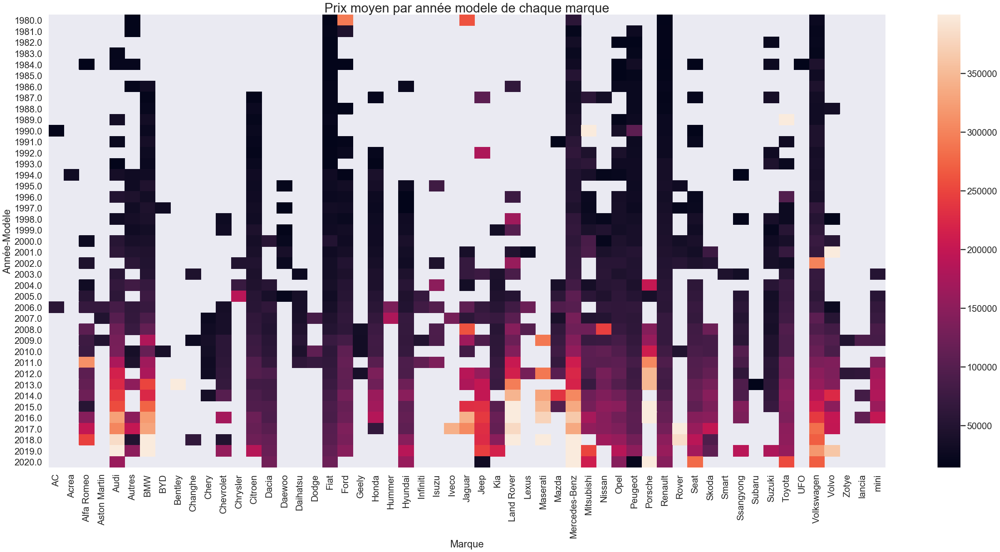

In [648]:
mat = pd.pivot_table(df_avito, values='prix', index='Année-Modèle', columns='Marque')
plt.figure(figsize=(45, 20))
sns.heatmap(mat , robust=True)
sns.set_context ( 'poster' , font_scale = 1.3)
plt.title("Prix moyen par année modele de chaque marque")


# Différences entre professionnels et particuliers

### Moyennes des prix pour chaque catégorie 

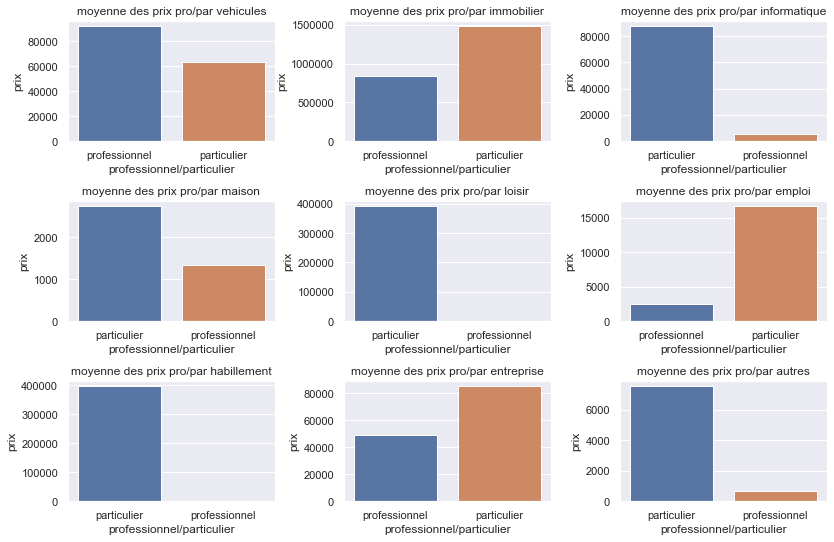

In [650]:
fig ,axes = plt.subplots(nrows = 3 , ncols = 3 , squeeze = False)
sns.set_context( 'notebook')
fig.tight_layout(pad = 3 , rect = (4,0,6,2)) 
i= 1
while i<9 :
    for d in pdList:
        plt.subplot(3, 3, i)
        sns.barplot(x = 'professionnel/particulier' , y = 'prix' , data = d , ci=.01)
        plt.title("moyenne des prix pro/par " + dfList[i-1] )
        i+=1

## Nombre d'annonces

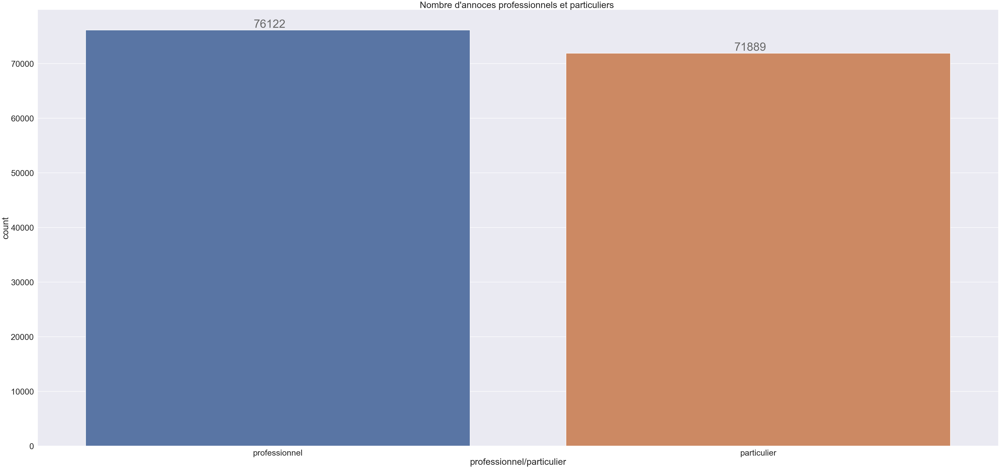

In [651]:
sns.set(style="darkgrid")
plt.figure(figsize=(75, 35))
sns.set_context ( 'poster' , font_scale = 1.65)

plt.title("Nombre d'annoces professionnels et particuliers ")

ax = sns.countplot( x='professionnel/particulier',  data = df_avito  )

totals = []
for i in ax.patches:
    totals.append(i.get_height())
total = sum(totals)
for i in ax.patches:
    ax.text(i.get_x()+.35, i.get_height()+500, str(int(round(i.get_height()/1, 2))), fontsize=50,color='dimgrey')

## Nombre d'annonceurs

#### traitement de quelques dataframes utilisées dans les plots suivants

In [652]:
df_pro = df_avito[df_avito['professionnel/particulier'] == 'professionnel']
df_pro_unique = df_pro.drop_duplicates(subset=['telephone'])
df_pro_unique_sorted = df_pro_unique.groupby('ville').count().sort_values('titre', ascending = False)
dpro = df_pro_unique_sorted[0:50]
nbr_pro = df_pro['telephone'].unique().shape[0]

df_par = df_avito[df_avito['professionnel/particulier'] == 'particulier']
df_par_unique = df_par.drop_duplicates(subset=['telephone'])
df_par_unique_sorted = df_par_unique.groupby('ville').count().sort_values('titre', ascending = False)
dpar = df_par_unique_sorted[0:50]
nbr_par = df_par['telephone'].unique().shape[0]

print("le nombre d'annonceur totale est :" , nbr_pro+nbr_par)

le nombre d'annonceur totale est : 46319


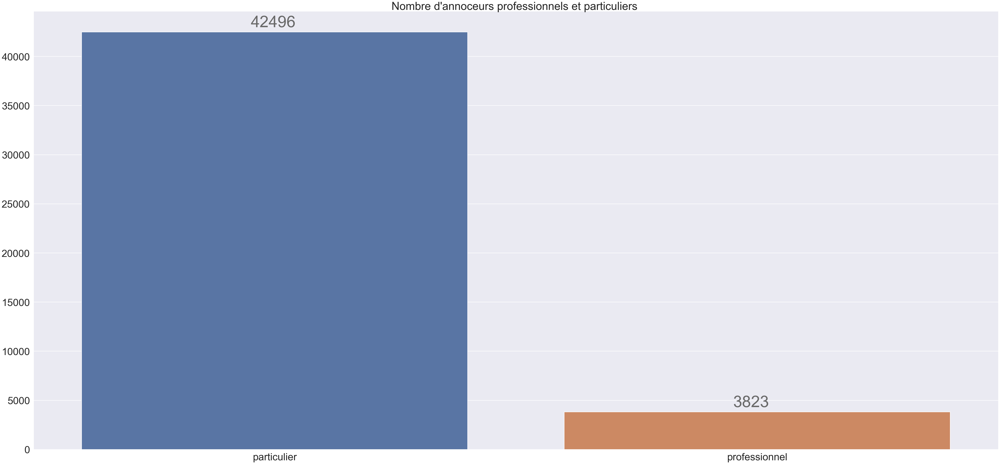

In [653]:
sns.set(style="darkgrid")
plt.figure(figsize=(75, 35))
sns.set_context ( 'poster' , font_scale = 2)
plt.title("Nombre d'annoceurs professionnels et particuliers ")
ax = sns.barplot(x = ['particulier', 'professionnel'] ,y =[nbr_par , nbr_pro] )
totals = []
for i in ax.patches:
    totals.append(i.get_height())
total = sum(totals)
for i in ax.patches:
    ax.text(i.get_x()+.35, i.get_height()+500, str(int(i.get_height())), fontsize=70,color='dimgrey')

## Nombre de vues

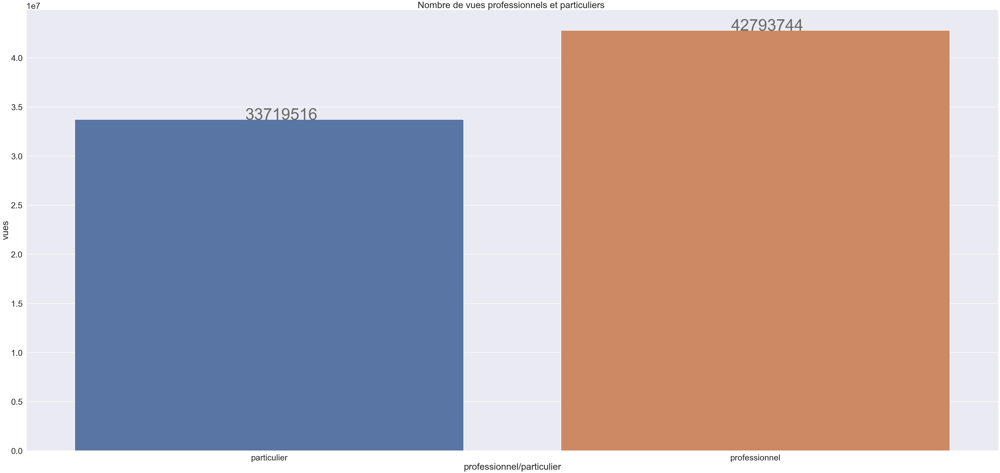

In [654]:
vue_pro_par = df_avito.groupby('professionnel/particulier').sum()[['vues']]

sns.set(style="darkgrid")
plt.figure(figsize=(75, 35))
sns.set_context ( 'poster' , font_scale = 1.65)

plt.title("Nombre de vues professionnels et particuliers ")

ax = sns.barplot(x=vue_pro_par.index , y = 'vues'  , data = vue_pro_par)

totals = []
for i in ax.patches:
    totals.append(i.get_height())
total = sum(totals)
for i in ax.patches:
    ax.text(i.get_x()+.35, i.get_height()+500, str(int(i.get_height())), fontsize=70,color='dimgrey')

## Nombre d'annonceurs par ville

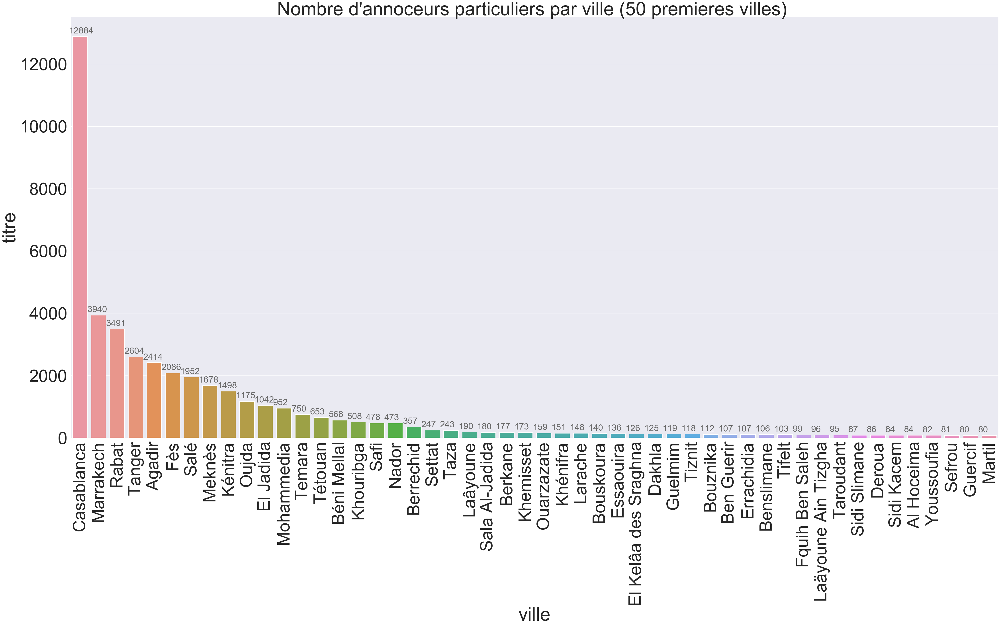

In [655]:
df = df_avito.drop_duplicates(subset='telephone')
dff = df.groupby('ville').count().sort_values('titre' , ascending = False)
l = dff[:50].index
sns.set(style="darkgrid")
plt.figure(figsize=(75, 35))
sns.set_context ( 'poster' , font_scale = 3.5)
plt.title("Nombre d'annoceurs particuliers par ville (50 premieres villes) ")
ax = sns.barplot(x=dff.index , y='titre', data=dff , order = l)
for item in ax.get_xticklabels():
    item.set_rotation(90)
    totals = []

for i in ax.patches:
    totals.append(i.get_height())
    
total = sum(totals)

for i in ax.patches:
    ax.text(i.get_x()-.2, i.get_height()+100, str(int((i.get_height()))), fontsize=40,color='dimgrey')

# IV / Quelques statistiques pour la catégorie immobilier
### ---------------1) Figure représentative les nombre d'annoces par type 

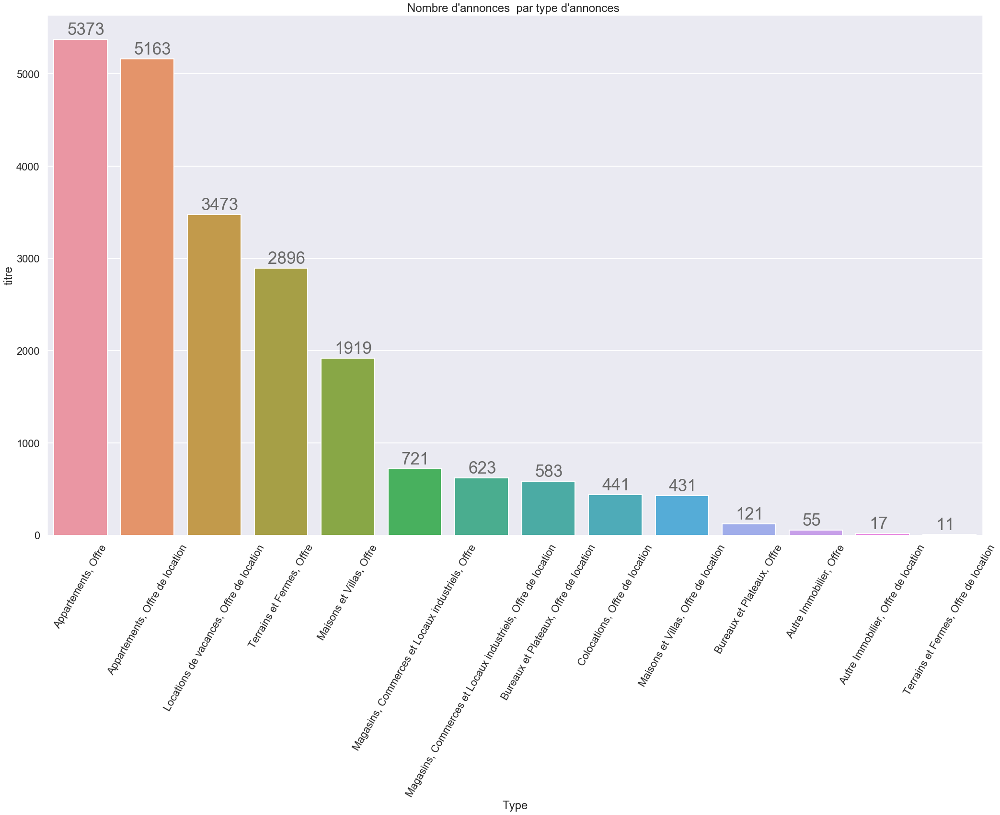

In [656]:
df = df_imm.groupby('Type').count().sort_values('titre' , ascending = False)
sns.set(style="darkgrid")
plt.figure(figsize=(35, 20))
sns.set_context ( 'poster')
ax = sns.barplot(x =  df.index ,y = 'titre', data = df )

plt.title("Nombre d'annonces  par type d'annonces ")
for item in ax.get_xticklabels():
    item.set_rotation(60)
totals = []

for i in ax.patches:
    totals.append(i.get_height())
    
total = sum(totals)

for i in ax.patches:
    ax.text(i.get_x()+.2, i.get_height()+50, str(int(i.get_height())), fontsize=35,color='dimgrey')

## Proportions des types d'annonces de la catégorie immobilier
### pie plot

Text(0.5, 1.0, "Proportions des types d'annonces de la catégorie immobilier")

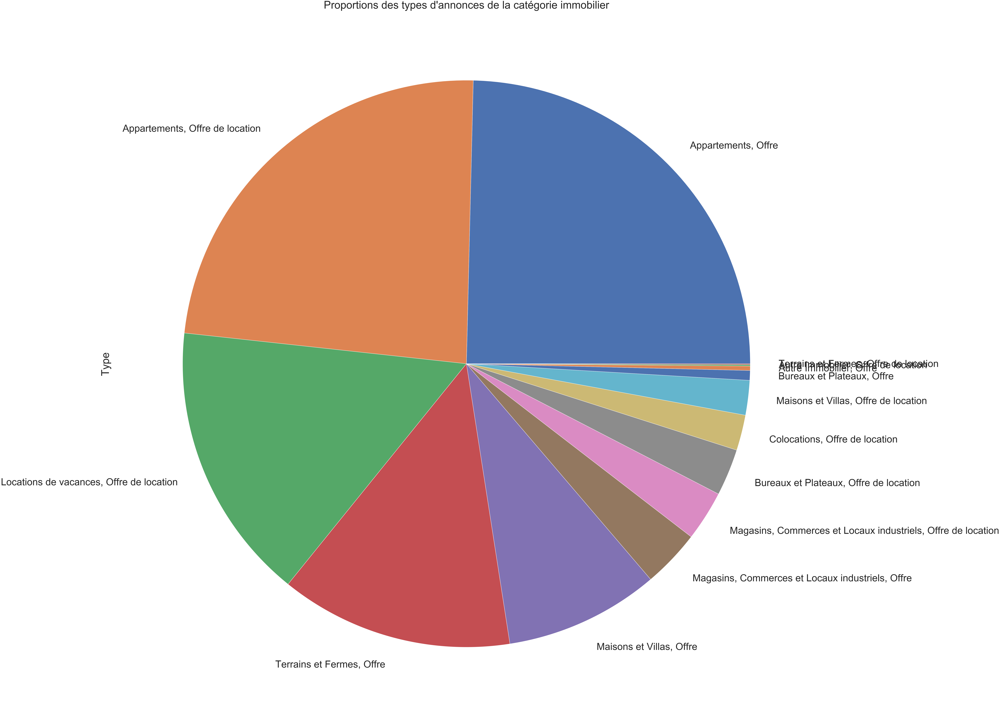

In [657]:
plt.figure(figsize=(100, 150))
sns.set_context ( 'poster' , font_scale = 3.5)
df_imm['Type'].value_counts(normalize = False).plot(kind = "pie")
plt.title("Proportions des types d'annonces de la catégorie immobilier"   )

### ---------------2) figure représentative les nombre d'annoces par nombre de pièces 

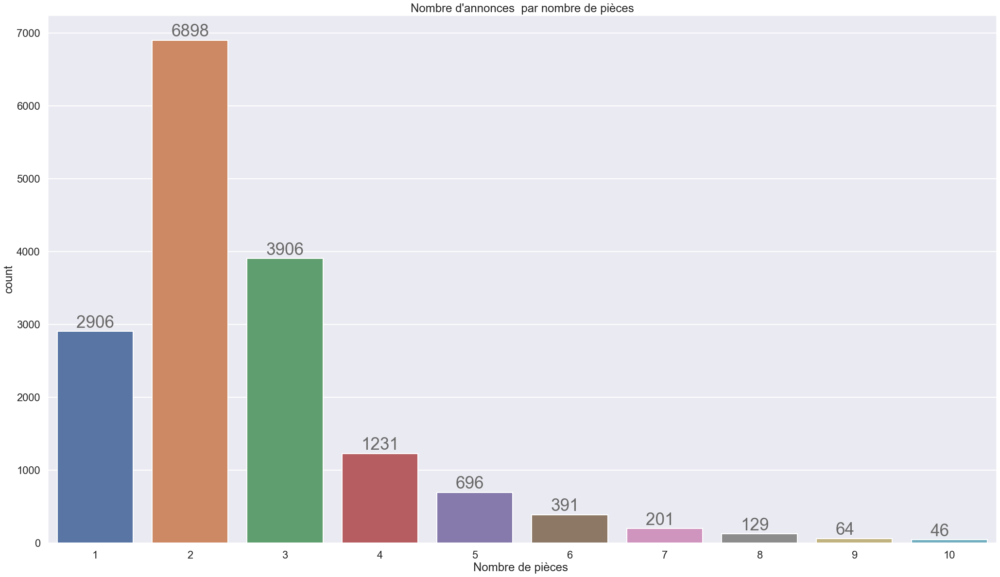

In [659]:

sns.set(style="darkgrid")
plt.figure(figsize=(35, 20))
sns.set_context ( 'poster')
ax = sns.countplot(df_imm['Nombre de pièces '] , order = list('123456789') + ['10' ])
plt.title("Nombre d'annonces  par nombre de pièces")
totals = []

for i in ax.patches:
    totals.append(i.get_height())
    
total = sum(totals)

for i in ax.patches:
    ax.text(i.get_x()+.2, i.get_height()+50, str(int(i.get_height())), fontsize=35,color='dimgrey')

### ---------------3) figure représentative des prix en fonction de la surface totale  

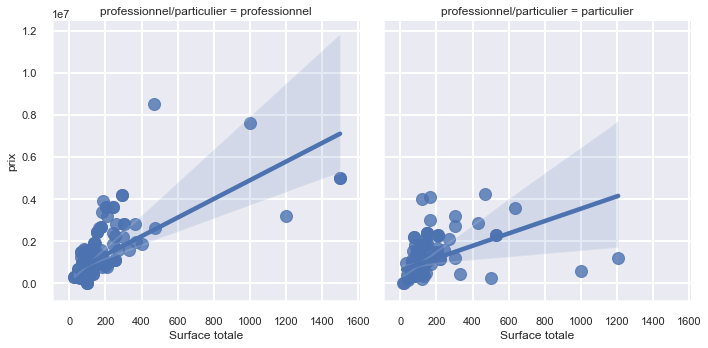

In [660]:
dd = df_imm[(df_imm['prix'] <= 10000000) & (df_imm['Surface totale'] <=2000)]

sns.set(style="darkgrid")
sns.set(rc={'figure.figsize':(20.7,18.27)})
sns.set_context ( 'poster' , font_scale = 0.5)
ax = sns.lmplot(x="Surface totale", y="prix", col = 'professionnel/particulier' ,data=dd.dropna() , robust = True )



# V / Quelques statistiques pour les autres catégories
### ---------------1) Figure représentative les nombre d'annoces par type 
#### catégorie informatique

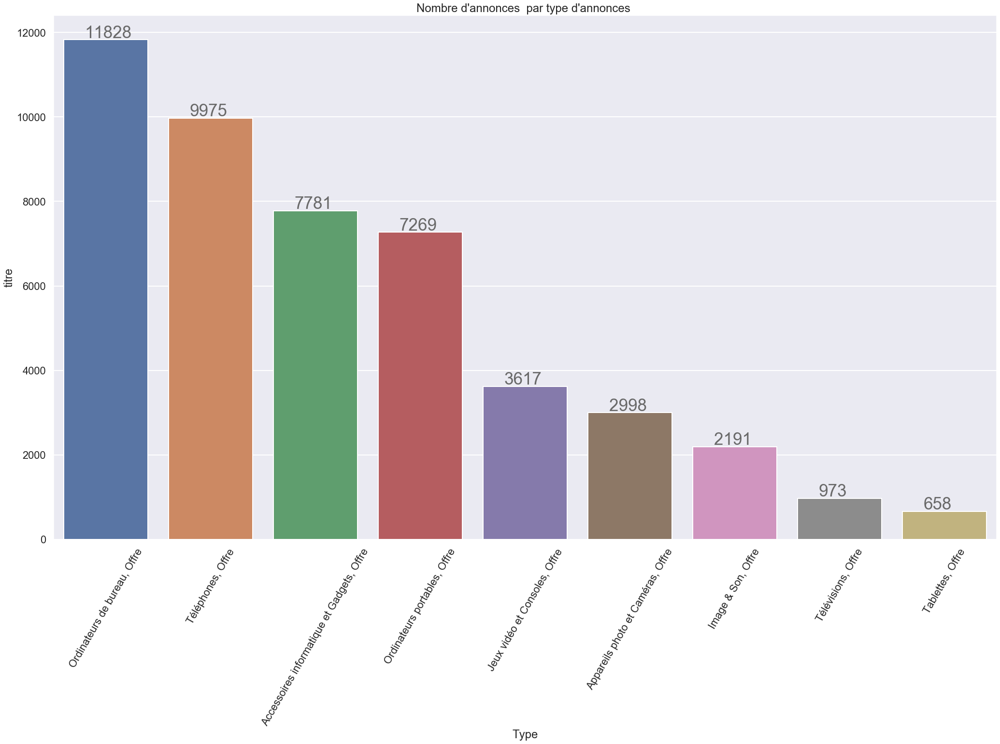

In [661]:
df = df_info.groupby('Type').count().sort_values('titre' , ascending = False)
sns.set(style="darkgrid")
plt.figure(figsize=(35, 20))
sns.set_context ( 'poster')
ax = sns.barplot(x =  df.index ,y = 'titre', data = df )

plt.title("Nombre d'annonces  par type d'annonces ")
for item in ax.get_xticklabels():
    item.set_rotation(60)
totals = []

for i in ax.patches:
    totals.append(i.get_height())
    
total = sum(totals)

for i in ax.patches:
    ax.text(i.get_x()+.2, i.get_height()+50, str(int(i.get_height())), fontsize=35,color='dimgrey')

#### pie plot catégorie informatique

Text(0.5, 1.0, "Proportions des types d'annonces de la catégorie informatique")

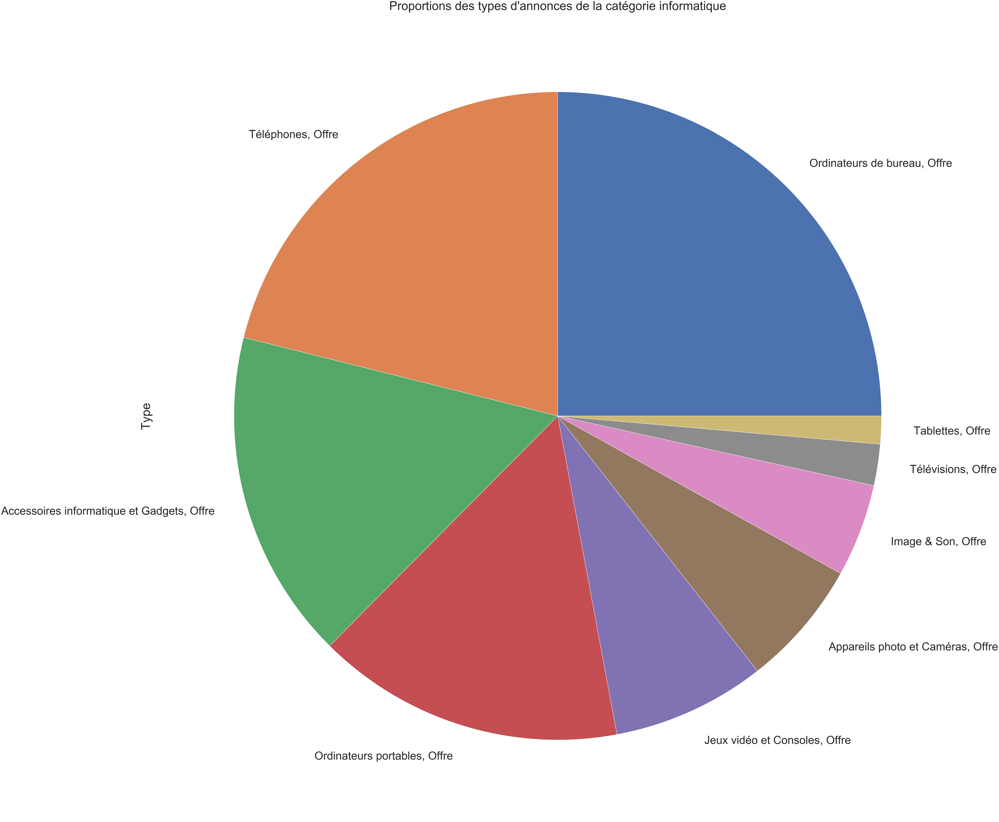

In [529]:
plt.figure(figsize=(100, 150))
sns.set_context ( 'poster' , font_scale = 3.5)
df_info['Type'].value_counts(normalize = False).plot(kind = "pie")
plt.title("Proportions des types d'annonces de la catégorie informatique" )

### ---------------2) Figure représentative les nombre d'annoces par type 
#### catégorie  emploi

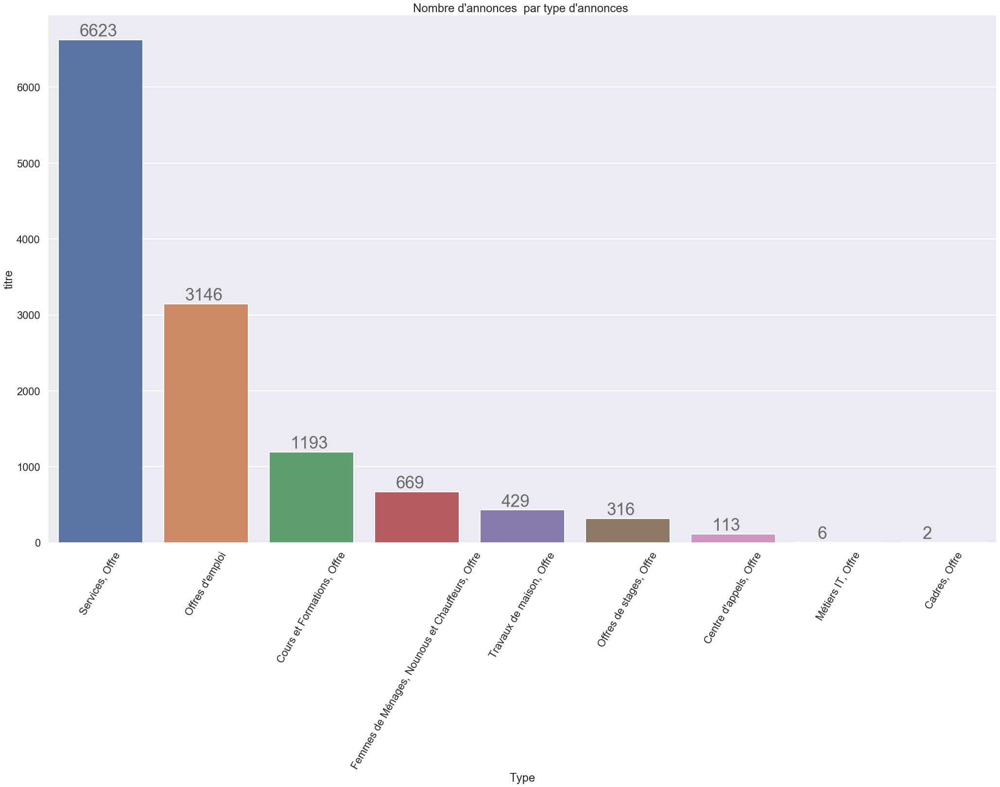

In [662]:
df = df_emp.groupby('Type').count().sort_values('titre' , ascending = False)
sns.set(style="darkgrid")
plt.figure(figsize=(35, 20))
sns.set_context ( 'poster')
ax = sns.barplot(x =  df.index ,y = 'titre', data = df )

plt.title("Nombre d'annonces  par type d'annonces ")
for item in ax.get_xticklabels():
    item.set_rotation(60)
totals = []

for i in ax.patches:
    totals.append(i.get_height())
    
total = sum(totals)

for i in ax.patches:
    ax.text(i.get_x()+.2, i.get_height()+50, str(int(i.get_height())), fontsize=35,color='dimgrey')

#### pie plot catégorie emploi

Text(0.5, 1.0, "Proportions des types d'annonces de la catégorie emploi")

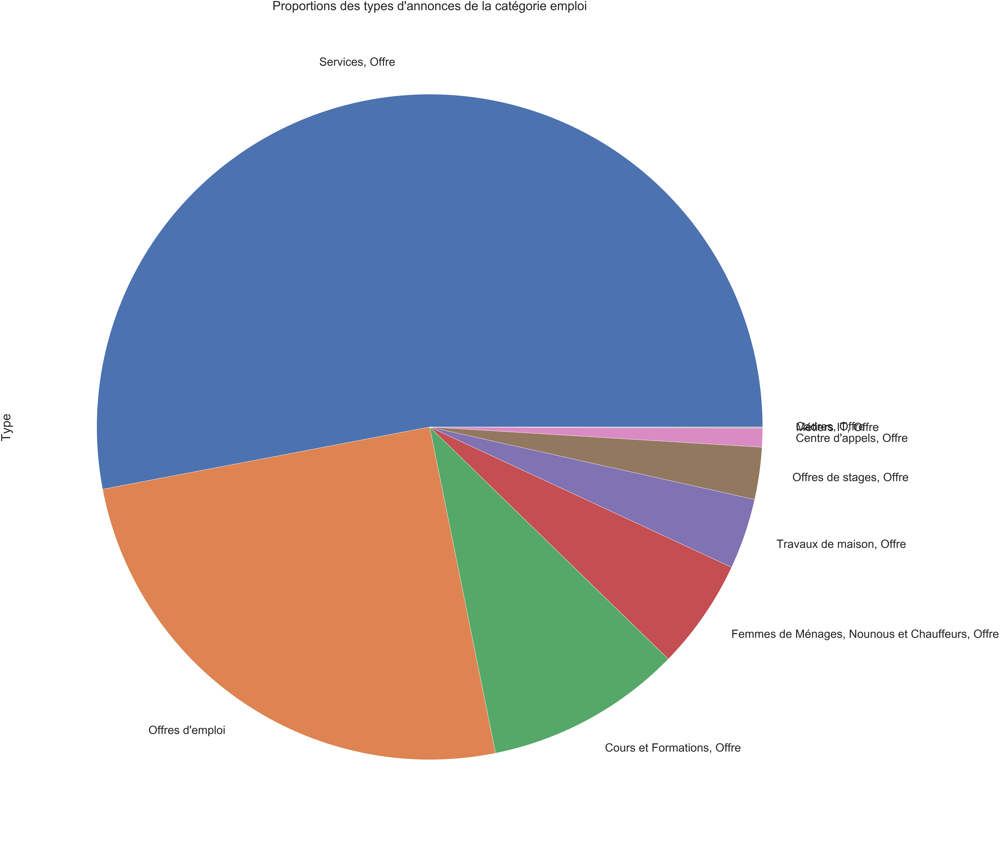

In [532]:
plt.figure(figsize=(100, 150))
sns.set_context ( 'poster' , font_scale = 3.5)
df_emp['Type'].value_counts(normalize = False).plot(kind = "pie")
plt.title("Proportions des types d'annonces de la catégorie emploi" )

### ---------------3) Figure représentative les nombre d'annoces par type 
#### catégorie entreprise

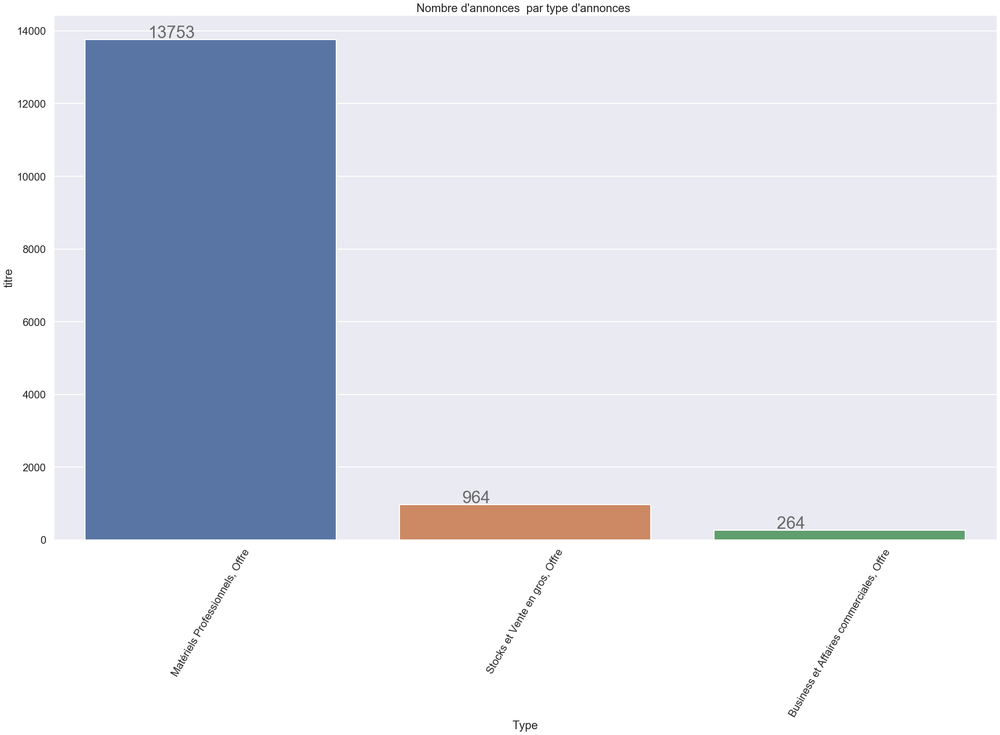

In [663]:
#figure représentative les nombre d'annoces par type dans la catégorie 
df = df_entr.groupby('Type').count().sort_values('titre' , ascending = False)
sns.set(style="darkgrid")
plt.figure(figsize=(35, 20))
sns.set_context ( 'poster')
ax = sns.barplot(x =  df.index ,y = 'titre', data = df )

plt.title("Nombre d'annonces  par type d'annonces ")
for item in ax.get_xticklabels():
    item.set_rotation(60)
totals = []

for i in ax.patches:
    totals.append(i.get_height())
    
total = sum(totals)

for i in ax.patches:
    ax.text(i.get_x()+.2, i.get_height()+50, str(int(i.get_height())), fontsize=35,color='dimgrey')

#### pie plot catégorie entreprise

Text(0.5, 1.0, "Proportions des types d'annonces de la catégorie entreprise")

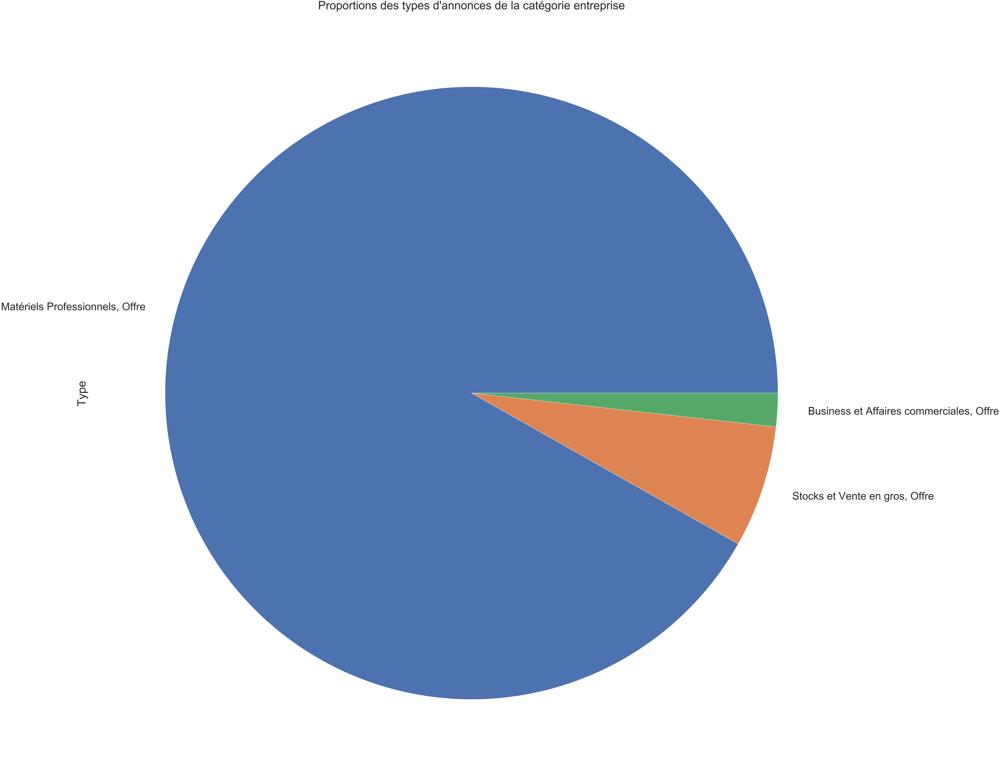

In [542]:
plt.figure(figsize=(100, 150))
sns.set_context ( 'poster' , font_scale = 3.5)
df_entr['Type'].value_counts(normalize = False).plot(kind = "pie")
plt.title("Proportions des types d'annonces de la catégorie entreprise" )

### ---------------4) Figure représentative les nombre d'annoces par type 
#### catégorie habillement

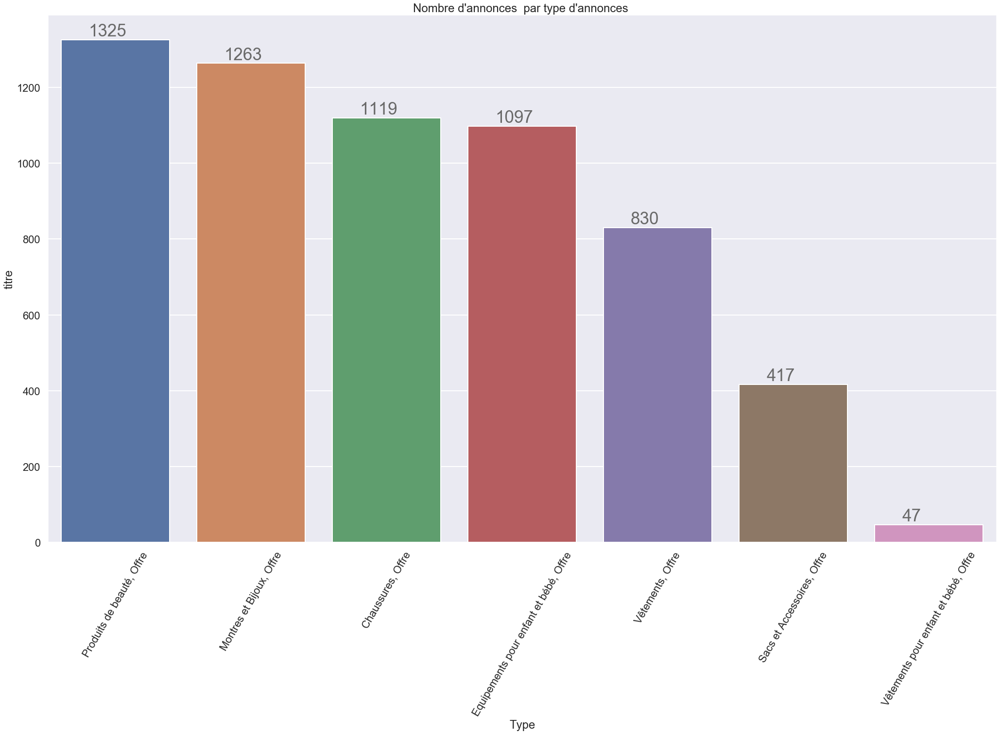

In [664]:
#figure représentative les nombre d'annoces par type dans la catégorie habillement
df = df_hab.groupby('Type').count().sort_values('titre' , ascending = False)
sns.set(style="darkgrid")
plt.figure(figsize=(35, 20))
sns.set_context ( 'poster')
ax = sns.barplot(x =  df.index ,y = 'titre', data = df )

plt.title("Nombre d'annonces  par type d'annonces ")
for item in ax.get_xticklabels():
    item.set_rotation(60)
totals = []

for i in ax.patches:
    totals.append(i.get_height())
    
total = sum(totals)

for i in ax.patches:
    ax.text(i.get_x()+.2, i.get_height()+10, str(int(i.get_height())), fontsize=35,color='dimgrey')

#### pie plot catégorie habillement

Text(0.5, 1.0, "Proportions des types d'annonces de la catégorie habillement")

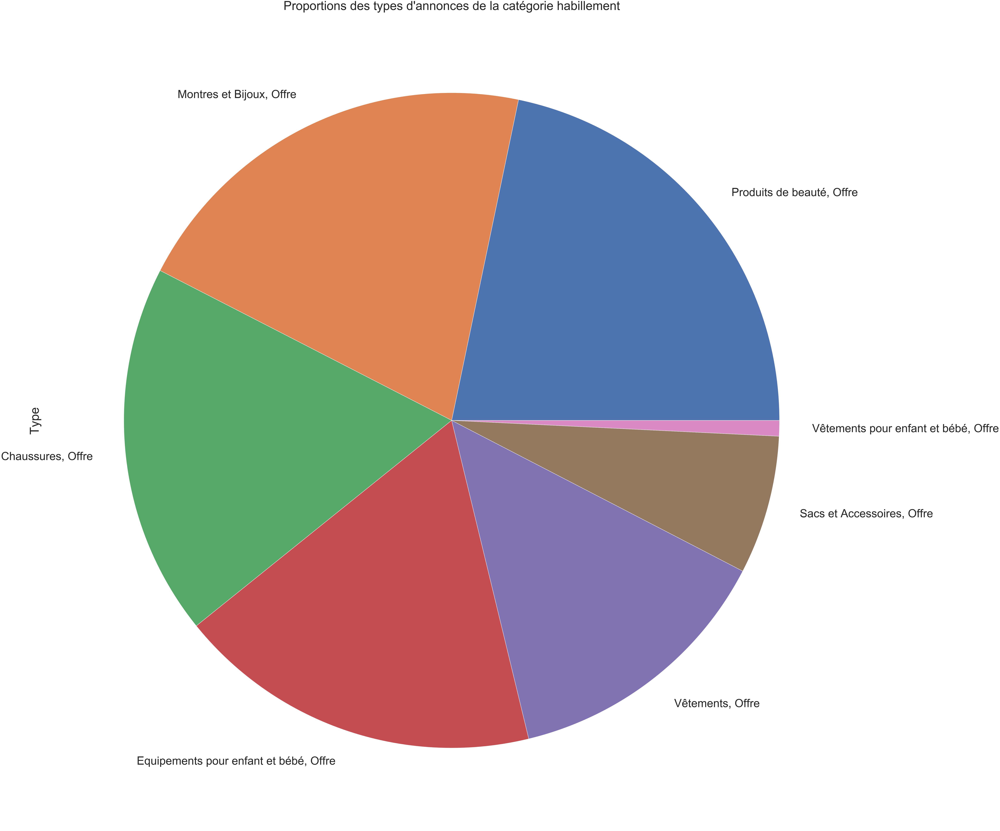

In [541]:
plt.figure(figsize=(100, 150))
sns.set_context ( 'poster' , font_scale = 3.5)
df_hab['Type'].value_counts(normalize = False).plot(kind = "pie")
plt.title("Proportions des types d'annonces de la catégorie habillement" )

### ---------------5) Figure représentative les nombre d'annoces par type 
#### catégorie loisir

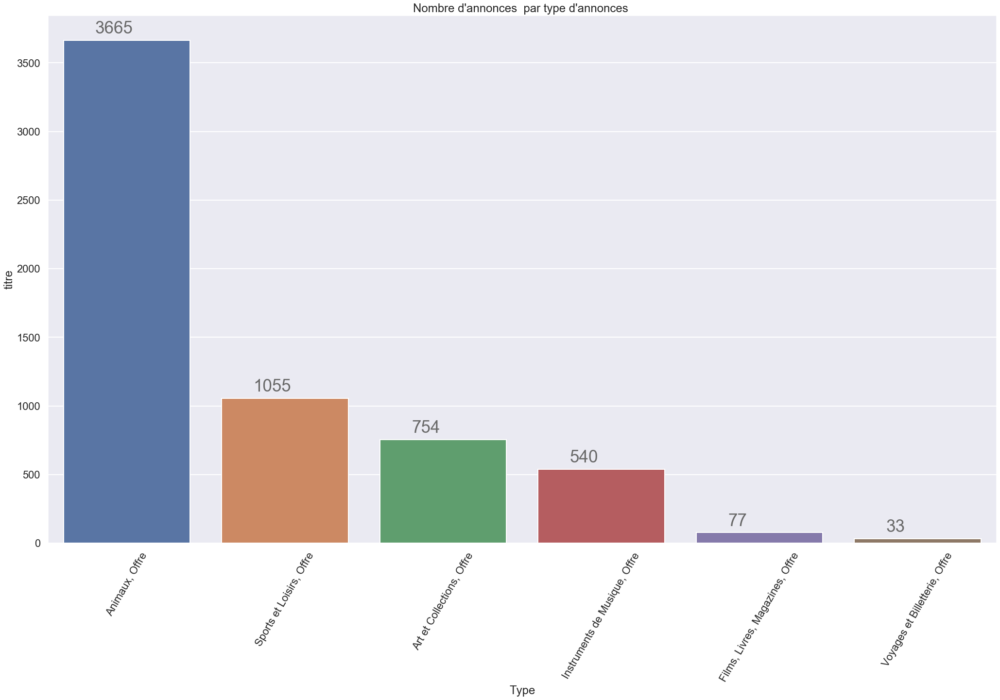

In [665]:
#figure représentative les nombre d'annoces par type dans la catégorie loisir
df = df_lois.groupby('Type').count().sort_values('titre' , ascending = False)
sns.set(style="darkgrid")
plt.figure(figsize=(35, 20))
sns.set_context ( 'poster')
ax = sns.barplot(x =  df.index ,y = 'titre', data = df )

plt.title("Nombre d'annonces  par type d'annonces ")
for item in ax.get_xticklabels():
    item.set_rotation(60)
totals = []

for i in ax.patches:
    totals.append(i.get_height())
    
total = sum(totals)

for i in ax.patches:
    ax.text(i.get_x()+.2, i.get_height()+50, str(int(i.get_height())), fontsize=35,color='dimgrey')

#### pie plot catégorie loisir

Text(0.5, 1.0, "Proportions des types d'annonces de la catégorie emploi")

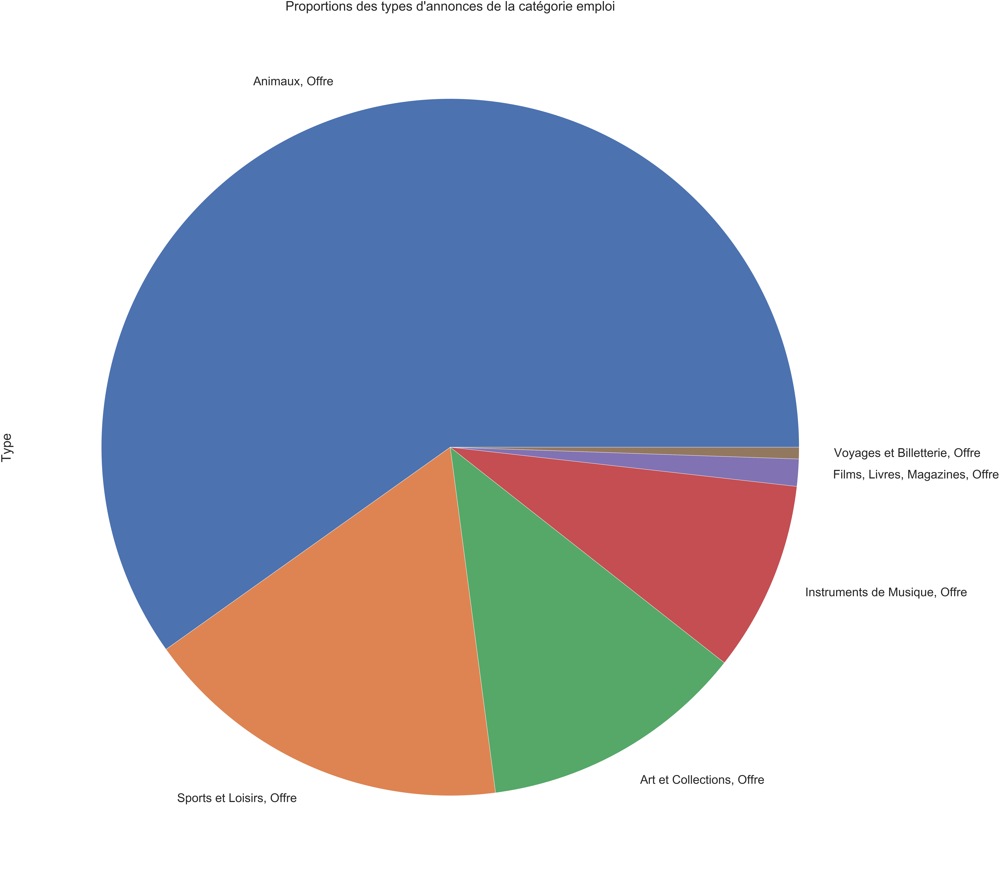

In [540]:
plt.figure(figsize=(100, 150))
sns.set_context ( 'poster' , font_scale = 3.5)
df_lois['Type'].value_counts(normalize = False).plot(kind = "pie")
plt.title("Proportions des types d'annonces de la catégorie loisir" )

### ---------------6) Figure représentative les nombre d'annoces par type 
#### catégorie maison

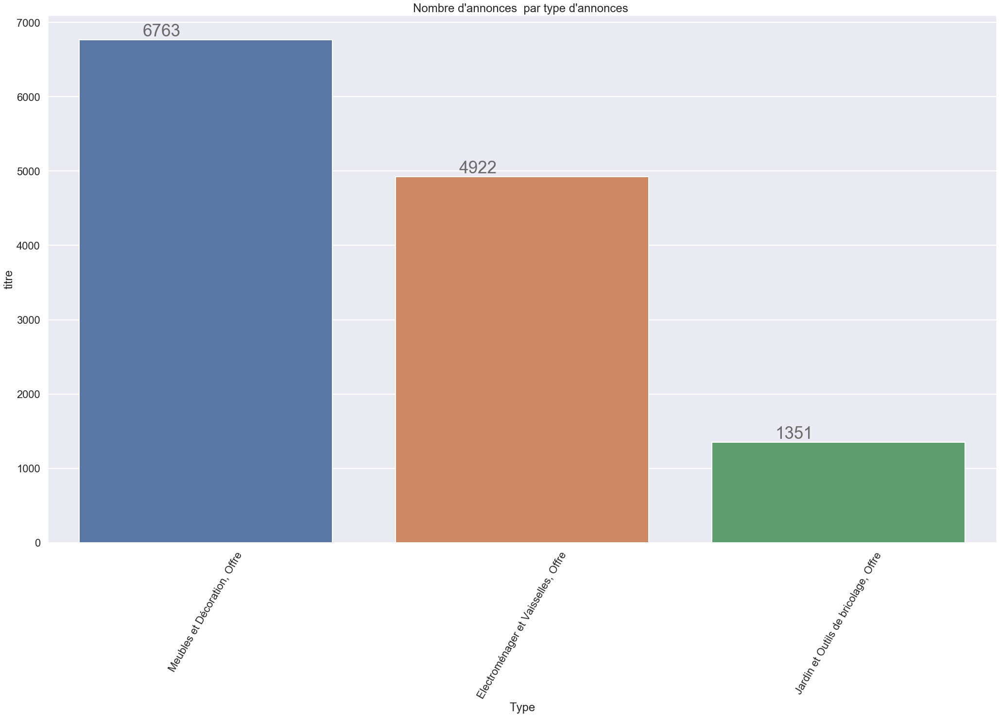

In [543]:
#figure représentative les nombre d'annoces par type dans la catégorie maison
df = df_maison.groupby('Type').count().sort_values('titre' , ascending = False)
sns.set(style="darkgrid")
plt.figure(figsize=(35, 20))
sns.set_context ( 'poster')
ax = sns.barplot(x =  df.index ,y = 'titre', data = df )

plt.title("Nombre d'annonces  par type d'annonces ")
for item in ax.get_xticklabels():
    item.set_rotation(60)
totals = []

for i in ax.patches:
    totals.append(i.get_height())
    
total = sum(totals)

for i in ax.patches:
    ax.text(i.get_x()+.2, i.get_height()+50, str(int(i.get_height())), fontsize=35,color='dimgrey')

#### pie plot catégorie maison

Text(0.5, 1.0, "Proportions des types d'annonces de la catégorie maison")

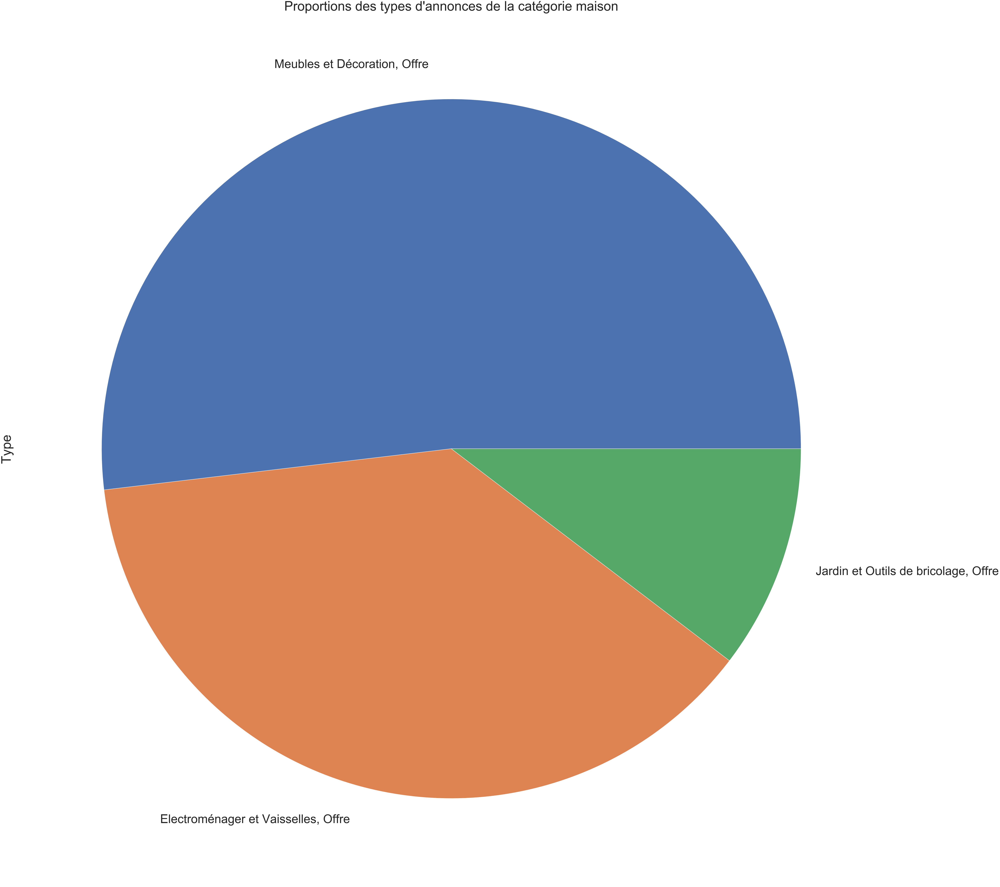

In [544]:
plt.figure(figsize=(100, 150))
sns.set_context ( 'poster' , font_scale = 3.5)
df_maison['Type'].value_counts(normalize = False).plot(kind = "pie")
plt.title("Proportions des types d'annonces de la catégorie maison" )

ce code a été pris du blog suivant : 
https://robertmitchellv.com/index.html
on s'en est servis pour afficher les pourcentages sur le haut des bars dans les plots 


In [569]:
totals = []

# find the values and append to list
for i in ax.patches:
    totals.append(i.get_height())

# set individual bar lables using above list
total = sum(totals)

# set individual bar lables using above list
for i in ax.patches:
    # get_x pulls left or right; get_height pushes up or down
    ax.text(i.get_x()-.03, i.get_height()+.5, str(round((i.get_height()/total)*100, 2))+'%', fontsize=15,color='dimgrey')